## Segmentation DeepLabV3Plus



## Neccessary Setup

In [ ]:
!apt-get -y install libopenjp2-7-dev libopenjp2-tools openslide-tools | tail --line 1
!pip install tiatoolbox seaborn | tail -n 1
ON_GPU=False
print('Installation is done.')
!pip install torch==1.9.1+cu102 torchvision==0.10.1+cu102 -f https://download.pytorch.org/whl/cu102/torch_stable.html --user
ON_GPU = True 
!pip install seaborn
!pip install Pillow==9.0.0
!pip install validators matplotlib
!pip install torch-summary
!pip uninstall matplotlib
!pip install matplotlib==3.1.3
!pip install captum
!pip install segmentation_models_pytorch
!pip install torchmetrics

Processing triggers for man-db (2.8.3-2ubuntu0.1) ...


Installation is done.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://download.pytorch.org/whl/cu102/torch_stable.html
     |████████████████████████████████| 831.4 MB 6.2 kB/s 
     |████████████████████████████████| 22.1 MB 43 kB/s 
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchtext 0.13.1 requires torch==1.12.1, but you have torch 1.9.1+cu102 which is incompatible.
torchaudio 0.12.1+cu113 requires torch==1.12.1, but you have torch 1.9.1+cu102 which is incompatible.
tiatoolbox 1.2.1 requires torch>=1.11.0, but you have torch 1.9.1+cu102 which is incompatible.
tiatoolbox 1.2.1 requires torchvision>=0.12.0, but you have torchvision 0.10.1+cu102 which is incompatibl

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Created wheel for validators: filename=validators-0.20.0-py3-none-any.whl size=19582 sha256=e0b9e8dc591beb932901cc0a279f627491fc47239e15dd971436e9d54bf362e9
  Stored in directory: /root/.cache/pip/wheels/5f/55/ab/36a76989f7f88d9ca7b1f68da6d94252bb6a8d6ad4f18e04e9
Successfully built validators
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Found existing installation: matplotlib 3.5.3
Uninstalling matplotlib-3.5.3:
  Would remove:
    /usr/local/lib/python3.7/dist-packages/matplotlib-3.5.3-py3.7-nspkg.pth
    /usr/local/lib/python3.7/dist-packages/matplotlib-3.5.3.dist-info/*
    /usr/local/lib/python3.7/dist-packages/matplotlib/*
    /usr/local/lib/python3.7/dist-packages/mpl_toolkits/axes_grid/*
    /usr/local/lib/python3.7/dist-packages/mpl_toolkits/axes_grid1/*
    /usr/local/lib/python3.7/dist-packages/mpl_toolkits/axisartist/*
   

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.4 MB 4.9 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 97 kB 3.7 MB/s 
     |████████████████████████████████| 58 kB 6.8 MB/s 
     |████████████████████████████████| 376 kB 38.4 MB/s 
  Created wheel for efficientnet-pytorch: filename=efficientnet_pytorch-0.7.1-py3-none-any.whl size=16446 sha256=f69147f28d179374390d3168b9ac9abddeffe77a27167b20f90884bf60d5dd5e
  Stored in directory: /root/.cache/pip/wheels/0e/cc/b2/49e74588263573ff778da58cc99b9c6349b496636a7e165be6
  Created wheel for pretrainedmodels: filename=pretrainedmodels-0.7.4-py3-none-any.whl size=60965 sha256=6580f32c352705cab8dc20c7e8287577ffae34a7d3af5a02e3d808f35cda7ac0
  Stored in directory: /root/.cache/pip/wheels/ed/27/e8/9543d42de2740d3544db96aefef63bda3f2c1761b3334f4873
Successfully 

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Mounted at /content/gdrive


In [ ]:
import tables
import cv2
from PIL import Image
from random import randint 
import torchvision
import tables as pt
import torch
import torch.nn as nn
import torchvision.transforms as transforms
import torchvision.transforms.functional as F
import torch.nn.functional as P
import random
import albumentations as A
import sys
from torch.utils.data import Dataset, DataLoader
import matplotlib.pyplot as plt 
import numpy as np
from tiatoolbox.tools import patchextraction
import time
import os
import copy
from sklearn.metrics import cohen_kappa_score,precision_score, recall_score, f1_score, multilabel_confusion_matrix, confusion_matrix
import pandas as pd
from sklearn.model_selection import train_test_split
import seaborn as sns 
import warnings
from torchmetrics import JaccardIndex
warnings.filterwarnings('ignore')
import pickle
import PIL 
from torchsummary import summary
from captum.attr import IntegratedGradients
from captum.attr import GradientShap
from tiatoolbox.models.engine.semantic_segmentor import (
    IOSegmentorConfig,
    SemanticSegmentor,
)
import math
from tqdm import tqdm
from torchmetrics.functional import jaccard_index
from captum.attr import Occlusion
from captum.attr import NoiseTunnel
from captum.attr import visualization as viz
from matplotlib.colors import LinearSegmentedColormap
from google.colab.patches import cv2_imshow
from skimage.morphology import reconstruction
from tiatoolbox.tools.tissuemask import MorphologicalMasker
plt.style.use('seaborn')
import segmentation_models_pytorch as smp
from segmentation_models_pytorch.encoders import get_preprocessing_fn
from torchvision.transforms.transforms import ToPILImage
from albumentations.pytorch.transforms import ToTensorV2

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
def imshow(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    #inp = std * inp + mean
    #inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)

In [ ]:
!unzip "/content/gdrive/MyDrive/Valid_full.zip" -d "/content"
!unzip "/content/gdrive/MyDrive/Train_full_grid_3.zip" -d "/content"


Streaming output truncated to the last 5000 lines.
  inflating: /content/Train_full_grid_3/images/2157.npy  
  inflating: /content/Train_full_grid_3/images/2165.npy  
  inflating: /content/Train_full_grid_3/images/2151.npy  
  inflating: /content/Train_full_grid_3/images/2156.npy  
  inflating: /content/Train_full_grid_3/images/2147.npy  
  inflating: /content/Train_full_grid_3/images/2153.npy  
  inflating: /content/Train_full_grid_3/images/2149.npy  
  inflating: /content/Train_full_grid_3/images/2148.npy  
  inflating: /content/Train_full_grid_3/images/2145.npy  
  inflating: /content/Train_full_grid_3/images/2146.npy  
  inflating: /content/Train_full_grid_3/images/2142.npy  
  inflating: /content/Train_full_grid_3/images/2161.npy  
  inflating: /content/Train_full_grid_3/images/2141.npy  
  inflating: /content/Train_full_grid_3/images/2158.npy  
  inflating: /content/Train_full_grid_3/images/2140.npy  
  inflating: /content/Train_full_grid_3/images/2144.npy  
  inflating: /content

In [ ]:
!unzip "/content/gdrive/MyDrive/Train_full_grid_2.zip" -d "/content"


Streaming output truncated to the last 5000 lines.
  inflating: /content/Train_full_grid_2/images/2637.npy  
  inflating: /content/Train_full_grid_2/masks/2107.npy  
  inflating: /content/Train_full_grid_2/masks/2101.npy  
  inflating: /content/Train_full_grid_2/images/3176.npy  
  inflating: /content/Train_full_grid_2/masks/2103.npy  
  inflating: /content/Train_full_grid_2/masks/2102.npy  
  inflating: /content/Train_full_grid_2/images/3177.npy  
  inflating: /content/Train_full_grid_2/masks/2594.npy  
  inflating: /content/Train_full_grid_2/masks/2104.npy  
  inflating: /content/Train_full_grid_2/images/2636.npy  
  inflating: /content/Train_full_grid_2/masks/2117.npy  
  inflating: /content/Train_full_grid_2/masks/2100.npy  
  inflating: /content/Train_full_grid_2/images/3175.npy  
  inflating: /content/Train_full_grid_2/masks/2106.npy  
  inflating: /content/Train_full_grid_2/masks/2596.npy  
  inflating: /content/Train_full_grid_2/masks/2592.npy  
  inflating: /content/Train_full

In [ ]:

img_dtype = tables.UInt8Atom()  # dtype in which the images will be saved, this indicates that images will be saved as unsigned int 8 bit, i.e., [0,255]
filenameAtom = tables.StringAtom(itemsize=255) #create an atom to store the filename of the image, just incase we need it later, 
training_directory = '/content/gdrive/MyDrive/1.training/1.training/'
validation_directory = '/content/gdrive/MyDrive/2.validation/2.validation/'
testing_directory = '/content/gdrive/MyDrive/3.testing/3.testing/'


In [ ]:
#Match the ground truth to the training image
X_image_strings = list()
training_y = list()

for image_string in os.listdir(training_directory):
  X_image_strings.append(os.path.join(training_directory,image_string))
  new_string = image_string[-13:-4].strip()
  new_label= [int(new_string[-8]),int(new_string[-5]),int(new_string[-2])]
  training_y.append(np.array(new_label))

In [ ]:
len(training_y)

10091

In [ ]:
#Match the ground truth to the training image
X_image_strings_valid = list()
y_valid_strings = list()

for image_string in os.listdir(validation_directory+'/img'):
    X_image_strings_valid.append(os.path.join(validation_directory+'img',image_string))
for image_string in os.listdir(validation_directory+'/mask'):
    y_valid_strings.append(os.path.join(validation_directory+'mask',image_string))


In [ ]:
def get_padding(image):
   
    
    #imsize = image.size
    height = image.shape[0]
    width = image.shape[1]


    height_padding = height % 16
    width_padding = width % 16
    
    if (height_padding!=0):
      height_padding = 16 - height_padding 
    if (width_padding!=0):
      width_padding = 16 - width_padding 

    top_padding = math.ceil(height_padding/2)
    bottom_padding = math.floor(height_padding/2)

    right_padding =math.ceil(width_padding/2)


    left_padding = math.floor(width_padding/2)
    

    print(height_padding)

    print(width_padding)
    print('done')

 
    
    padding = (int(top_padding), int(bottom_padding), int(left_padding), int(right_padding))
    
    return padding


In [ ]:
len(training_y)

10091

In [ ]:
non_single_class_images = list()
non_single_class_images_y = list()
only_tumour_i = list()
only_stroma_i = list()
only_normal_i = list()
listing_dir = os.listdir(training_directory)
for i in range(len(listing_dir)):
   print(i)
   io=cv2.cvtColor(cv2.imread(training_directory+listing_dir[i]),cv2.COLOR_BGR2RGB)
   interp_method=PIL.Image.BICUBIC
   io = cv2.resize(io,(0,0),fx=1,fy=1, interpolation=interp_method) #resize it as specified above
   io = cv2.resize(io,(224,224))

   if all(training_y[i] == [1,0,0]):
      only_tumour_i.append(io)
   elif all(training_y[i] == [0,1,0]):
      only_stroma_i.append(io)
   elif all(training_y[i] == [0,0,1]):
      only_normal_i.append(io)
   else:
     non_single_class_images.append(io)
     non_single_class_images_y.append(training_y[i])

Streaming output truncated to the last 5000 lines.
5091
5092
5093
5094
5095
5096
5097
5098
5099
5100
5101
5102
5103
5104
5105
5106
5107
5108
5109
5110
5111
5112
5113
5114
5115
5116
5117
5118
5119
5120
5121
5122
5123
5124
5125
5126
5127
5128
5129
5130
5131
5132
5133
5134
5135
5136
5137
5138
5139
5140
5141
5142
5143
5144
5145
5146
5147
5148
5149
5150
5151
5152
5153
5154
5155
5156
5157
5158
5159
5160
5161
5162
5163
5164
5165
5166
5167
5168
5169
5170
5171
5172
5173
5174
5175
5176
5177
5178
5179
5180
5181
5182
5183
5184
5185
5186
5187
5188
5189
5190
5191
5192
5193
5194
5195
5196
5197
5198
5199
5200
5201
5202
5203
5204
5205
5206
5207
5208
5209
5210
5211
5212
5213
5214
5215
5216
5217
5218
5219
5220
5221
5222
5223
5224
5225
5226
5227
5228
5229
5230
5231
5232
5233
5234
5235
5236
5237
5238
5239
5240
5241
5242
5243
5244
5245
5246
5247
5248
5249
5250
5251
5252
5253
5254
5255
5256
5257
5258
5259
5260
5261
5262
5263
5264
5265
5266
5267
5268
5269
5270
5271
5272
5273
5274
5275
5276
5277
5278
5279
5280

In [ ]:
len(only_tumour_i)

1181

In [ ]:
def sort_data(file_loc_data ,directory):
  test_X_data = list()
  test_y_data = list()
  test_mask_data = list()
  # Sort validation data 
  for i in range(len(file_loc_data)):
    # We need to sort if the image is large or not
    io=cv2.cvtColor(cv2.imread(file_loc_data[i]),cv2.COLOR_BGR2RGB)
    io_mask = cv2.cvtColor(cv2.imread(directory+'/mask'+file_loc_data[i][-7:]),cv2.COLOR_BGR2RGB)
    count = 0 
    interp_method=PIL.Image.BICUBIC
    io = cv2.resize(io,(0,0),fx=1,fy=1, interpolation=interp_method) #resize it as specified above
    io_mask = cv2.resize(io_mask,(0,0),fx=1,fy=1, interpolation=interp_method) #resize it as specified above
    all_padding = get_padding(io)
    print(io.shape)

    io = np.pad(io, pad_width=((all_padding[0], all_padding[1]), (all_padding[2], all_padding[3]),(0,0)))
    io_mask = np.pad(io_mask, pad_width=((all_padding[0], all_padding[1]), (all_padding[2], all_padding[3]),(0,0)))
    print(io.shape)

    io_mask_map = map(int,[(io_mask == (0,64,128)).all(axis=-1).max(), (io_mask == (64,128,0)).all(axis=-1).max(), (io_mask == (243,152,0)).all(axis=-1).max()])
    io_mask_y_int = list(io_mask_map)
    test_X_data.append(io)
    test_y_data.append(io_mask_y_int)
    test_mask_data.append(io_mask)
  return test_X_data, test_y_data, test_mask_data


In [ ]:

training_X = list()
training_y = list()
validation_X = list()
validation_y = list()


for i in range(3761):
  number = str(i)
  training_X.append(np.load('/content/Train_full_grid_3/images/'+number+'.npy'))
  training_y.append(np.load('/content/Train_full_grid_3/masks/'+number+'.npy'))




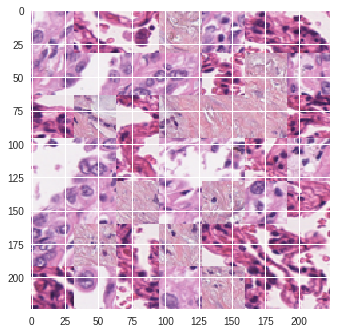

In [ ]:
plt.imshow(training_X[50])

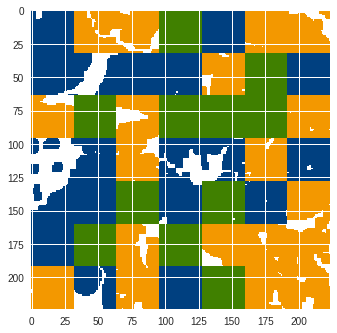

In [ ]:
plt.imshow(training_y[50])

In [ ]:
validation_X, validation_y_labels, validation_y = sort_data(X_image_strings_valid, validation_directory)

11
12
done
(485, 276, 3)
(496, 288, 3)
15
6
done
(273, 266, 3)
(288, 272, 3)
13
0
done
(291, 352, 3)
(304, 352, 3)
3
14
done
(269, 242, 3)
(272, 256, 3)
12
2
done
(452, 398, 3)
(464, 400, 3)
11
1
done
(341, 223, 3)
(352, 224, 3)
11
5
done
(485, 475, 3)
(496, 480, 3)
3
5
done
(349, 251, 3)
(352, 256, 3)
6
1
done
(458, 255, 3)
(464, 256, 3)
4
14
done
(428, 274, 3)
(432, 288, 3)
11
12
done
(293, 228, 3)
(304, 240, 3)
12
3
done
(500, 365, 3)
(512, 368, 3)
10
7
done
(454, 313, 3)
(464, 320, 3)
14
13
done
(370, 419, 3)
(384, 432, 3)
1
2
done
(287, 350, 3)
(288, 352, 3)
0
10
done
(400, 310, 3)
(400, 320, 3)
4
15
done
(236, 353, 3)
(240, 368, 3)
11
7
done
(389, 233, 3)
(400, 240, 3)
15
3
done
(465, 397, 3)
(480, 400, 3)
15
13
done
(337, 227, 3)
(352, 240, 3)
3
13
done
(493, 243, 3)
(496, 256, 3)
3
8
done
(237, 280, 3)
(240, 288, 3)
11
11
done
(341, 245, 3)
(352, 256, 3)
6
7
done
(474, 217, 3)
(480, 224, 3)
14
9
done
(498, 327, 3)
(512, 336, 3)
2
8
done
(206, 248, 3)
(208, 256, 3)
13
8
done
(41

In [ ]:
def create_testing_masks(masks):
  new_masks = list()
  for mask in masks:
    this_mask = mask.copy()
    this_mask = this_mask[:, :,1]
    
    np.putmask(this_mask, this_mask == 0, 0)
    np.putmask(this_mask, this_mask == 255, 0)
    np.putmask(this_mask, this_mask == 64, 1)
    np.putmask(this_mask, this_mask == 128, 2)
    np.putmask(this_mask, this_mask == 152, 3)
    new_masks.append(this_mask)
  return new_masks 

In [ ]:
training_y_new = create_testing_masks(training_y)

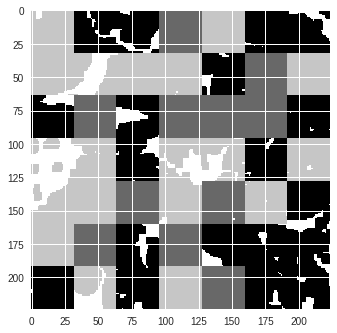

In [ ]:
plt.imshow(training_y_new[50])

In [ ]:
training_y_new[50]

array([[1, 1, 1, ..., 3, 3, 3],
       [1, 1, 1, ..., 3, 3, 3],
       [1, 1, 1, ..., 3, 3, 3],
       ...,
       [3, 3, 3, ..., 3, 3, 3],
       [3, 3, 3, ..., 3, 3, 3],
       [3, 3, 3, ..., 3, 3, 3]], dtype=uint8)

## Cutmix


In [ ]:
def rand_bbox(size, lamb):
    """ Generate random bounding box 
    Args:
        - size: [width, breadth] of the bounding box
        - lamb: (lambda) cut ratio parameter, sampled from Beta distribution
    Returns:
        - Bounding box
    """

    # Generate random bounding box inside area 
    W = size[0]
    H = size[1]
    cut_rat = np.sqrt(1. - lamb)
    cut_w = np.int(W * cut_rat)
    cut_h = np.int(H * cut_rat)

    # uniform
    cx = np.random.randint(W)
    cy = np.random.randint(H)

    bbx1 = np.clip(cx - cut_w // 2, 0, W)
    bby1 = np.clip(cy - cut_h // 2, 0, H)
    bbx2 = np.clip(cx + cut_w // 2, 0, W)
    bby2 = np.clip(cy + cut_h // 2, 0, H)

    return bbx1, bby1, bbx2, bby2

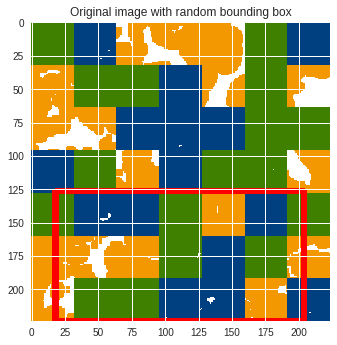

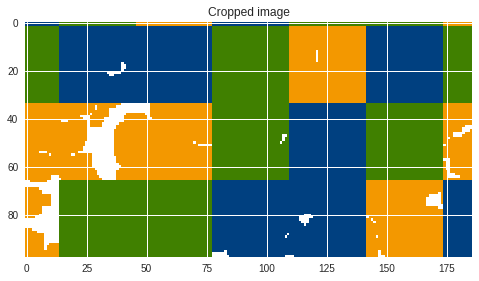

In [ ]:
image = training_y[25]

# Crop a random bounding box
lamb = 0.3
size = image.shape
#padding = get_padding(image)
bbox = rand_bbox(size, lamb)

# Draw bounding box on the image
im = image.copy()
x1 = bbox[0]
y1 = bbox[1]
x2 = bbox[2]
y2 = bbox[3]
cv2.rectangle(im, (x1, y1), (x2, y2), (255, 0, 0), 3)
plt.imshow(im);
plt.title('Original image with random bounding box')
plt.show();

# Show cropped image
plt.imshow(image[y1:y2, x1:x2]);
plt.title('Cropped image')
plt.show()

In [ ]:
def generate_cutmix_image(image_one,image_one_mask, image_two, image_two_mask, beta):
    ## Generate cutmix image specifically for one image at a time. 
    # generate mixed sample
    lam = np.random.beta(beta, beta)
 
    bbx1, bby1, bbx2, bby2 = rand_bbox(image_one.shape, lam)
    #raw_image = cv2.resize(image_two,(224,224))

    image_batch_updated = image_one.copy()
    image_batch_updated[bbx1:bbx2, bby1:bby2, :] = image_two[bbx1:bbx2, bby1:bby2, :]

    image_batch_mask_updated = image_one_mask.copy()
    image_batch_mask_updated[bbx1:bbx2, bby1:bby2] = image_two_mask[bbx1:bbx2, bby1:bby2]

    
    return image_batch_updated, image_batch_mask_updated

In [ ]:
def produce_all_cutmix_images():
  pairings = [[(training_X[:300],training_y[:300]),(training_X[300:600],training_y[300:600])], [(training_X[1500:1800],training_y[1500:1800]), (training_X[1800:2100],training_y[1800:2100])]]
  cutmix_images = list()
  cutmix_masks = list()
  for pair in pairings:
    print(len(pair[0][0]))

    for i in range(300):
      
      cutmix_image, cutmix_mask = generate_cutmix_image(pair[0][0][i],pair[0][1][i], pair[1][0][i],pair[1][1][i],1.0)
      cutmix_images.append(cutmix_image)
      cutmix_masks.append(cutmix_mask)


  return cutmix_images, cutmix_masks


In [ ]:
cutmix_images, cutmix_masks = produce_all_cutmix_images()

300
300


In [ ]:
training_X.extend(cutmix_images)
training_y.extend(cutmix_masks)

In [ ]:
training_y_new = create_testing_masks(training_y)

## Data import

In [ ]:
seed = random.randrange(sys.maxsize)


In [ ]:
seed

8766135436084429175

In [ ]:
class WSSS4LUAD_seg_train(Dataset):
  def __init__(self):
    self.x = np.array(training_X)
    self.masks = np.array(training_y_new)
    self.n_samples =  self.x.shape[0]
    

  def transform(self, image, mask):
    toPIL = transforms.ToPILImage()
    image = toPIL(image)
    mask = toPIL(mask)
    if random.random() >0.6:
      angle = random.randint(-30, 30)
      image = F.rotate(image,angle)
      mask = F.rotate(mask,angle)
    if random.random() >0.6:
      image = F.hflip(image)
      mask = F.hflip(mask)
    if random.random()>0.9:
      image = F.vflip(image)
      mask = F.vflip(mask)
    
    totens = transforms.ToTensor()
    image = totens(image)
    return image,np.array(mask)
    



  def __getitem__(self,index):
    image = self.x[index]
    mask = self.masks[index]
    image,mask = self.transform(image,mask)
    

    return image, mask

          
  
  def __len__(self):
    return self.n_samples

class WSSS4LUAD_seg_valid(Dataset):
  def __init__(self, img_transform=None,mask_transform=None):
    self.x = np.array(valid_X_data)
    self.masks = np.array(valid_mask_data)
    self.n_samples =  self.x.shape[0]
    self.img_transform = img_transform
    self.mask_transform = mask_transform


  def __getitem__(self,index):
    image = self.x[index]
    mask = self.masks[index]
    image = self.x[index]
    mask = self.masks[index]

    if self.img_transform is not None :
      image = self.img_transform(image)
    if self.mask_transform is not None: 
      mask = self.mask_transform(mask)
    return image, np.array(mask)

  def __len__(self):
    return self.n_samples



## Training and validation

In [ ]:
def seg_train (dataloader, model, optimizer, loss_function,test_batch=None):
  progress = tqdm(dataloader)  
  train_loss = 0
  count = 0
  model.train()
  
  for batch_idx, (data, masks) in enumerate(progress):
    count += 1 
    data = data.type(torch.FloatTensor)
    
    X = data.to(device)
    y = masks.type('torch.LongTensor').to(device)

    with torch.set_grad_enabled(True):
      predictions = model(X)
      loss = loss_function(predictions,y)
      optimizer.zero_grad()
      loss = loss.mean()
      train_loss += loss
      #print(loss)
      loss.backward()
      optimizer.step()

     
  print(train_loss/count)
  progress.set_postfix({'Train loss': train_loss/count})    
  return train_loss/count

In [ ]:
def seg_validate (dataloader, model, optimizer, loss_function):
  progress = tqdm(dataloader)  
  model.eval()
  jaccard = JaccardIndex(num_classes=4, average='none')
  IoU_background = 0.0
  IoU_tumour = 0.0
  IoU_stroma = 0.0
  IoU_normal = 0.0
  cmatrix = np.zeros((4,4))
  tumour_count = 29  
  stroma_count = 30
  normal_count = 5
  count = 0


  for batch_idx, (data, masks) in enumerate(progress):
    count += 1 
    data = data.type(torch.FloatTensor)
    X = data.to(device)
    y = masks.type('torch.LongTensor').to(device)

    with torch.set_grad_enabled(False):
       predictions = model(X)
       # Create 4d from prediction
       p=predictions[:,:,:,:].detach().cpu()
       cpred=np.argmax(p,axis=1)
       y_cpu=y.cpu()
       print(y_cpu.shape)
       print(cpred.shape)

       jaccard_batch_metric = jaccard(cpred,y_cpu)
       print(jaccard_batch_metric)
       IoU_background += jaccard_batch_metric[0]
       IoU_tumour += jaccard_batch_metric[1]
       IoU_stroma += jaccard_batch_metric[2]
       IoU_normal += jaccard_batch_metric[3]
       cpredflat = cpred.flatten()
       yflat = y_cpu.flatten()

       cmatrix=cmatrix+confusion_matrix(yflat,cpredflat,labels=range(4))
  
  all_metrics = {
      'Accuracy': (cmatrix/cmatrix.sum()).trace(),
      'IoU Tumour': IoU_tumour/tumour_count,
      'IoU Stroma': IoU_stroma/stroma_count,
      'IoU Normal':IoU_normal/normal_count,
      'IoU Background':IoU_background/count,
  }

  return all_metrics, cmatrix 

   


      



## Model Creation

In [ ]:
model = smp.DeepLabV3Plus(
    encoder_name="resnet50",        # choose encoder, e.g. mobilenet_v2 or efficientnet-b7
    encoder_weights=None,     # use `imagenet` pre-trained weights for encoder initialization
    in_channels=3,                  # model input channels (1 for gray-scale images, 3 for RGB, etc.)
    classes=4,                      # model output channels (number of classes in your dataset)
).to(device)

In [ ]:
torch.load('/content/gdrive/MyDrive/deeplabplus_resnet50_grid_large.pth')

{'epoch': 100,
 'loss': CrossEntropyLoss(),
 'model_state_dict': OrderedDict([('encoder.conv1.weight',
               tensor([[[[-1.1595e-02, -8.1880e-04,  4.7279e-02,  ..., -5.4094e-02,
                           1.3196e-02,  8.6355e-03],
                         [ 4.2152e-02, -7.6997e-02,  1.1005e-02,  ..., -5.4870e-02,
                           5.9336e-03,  8.7412e-03],
                         [-1.3161e-02, -2.1428e-02, -2.8353e-02,  ..., -2.9282e-02,
                          -2.3620e-02, -2.5477e-02],
                         ...,
                         [ 5.4055e-02, -3.5115e-02,  5.4374e-03,  ..., -2.3438e-02,
                           1.2454e-03, -3.9233e-02],
                         [ 1.4073e-02, -2.0368e-02, -1.6231e-02,  ..., -4.7139e-02,
                          -1.5598e-02, -2.1454e-02],
                         [-6.0578e-03, -3.4659e-02, -8.6605e-04,  ..., -3.7281e-02,
                          -5.0871e-02, -4.1377e-02]],
               
                        [[-4

In [ ]:
model.load_state_dict(torch.load('/content/gdrive/MyDrive/deeplabplus_50_grid_after.pth')['model_state_dict'])

<All keys matched successfully>

In [ ]:
scaler = torch.cuda.amp.GradScaler()

In [ ]:
optim = torch.optim.Adam(model.parameters(), lr=0.0007) # Adam is going to be the most robust

criterion = nn.CrossEntropyLoss(reduce=False)


## Augmentations

In [ ]:
img_transform = transforms.Compose([
     transforms.ToPILImage(),
     transforms.RandomRotation(degrees=45),
     transforms.RandomHorizontalFlip(p=0.5),
     transforms.RandomVerticalFlip(p=0.05),
     transforms.ToTensor()
    ])


mask_transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.RandomRotation(degrees=45),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomVerticalFlip(p=0.05),
    transforms.ToTensor()
    #transforms.ToPILImage(),
    #transforms.Resize(patch_size),
    ])


img_transform_valid = transforms.Compose([
     #transforms.ToPILImage(),
    
     transforms.ToTensor()
    ])


mask_transform_valid = transforms.Compose([
    #transforms.ToPILImage(),
    #transforms.Resize(patch_size),
    ])

In [ ]:
segmentation_train = WSSS4LUAD_seg_train()
dataloader_segmentation_train = DataLoader(dataset = segmentation_train, batch_size = 32, shuffle = True)
segmentation_valid = WSSS4LUAD_seg_valid(img_transform_valid,mask_transform_valid)
dataloader_segmentation_valid = DataLoader(dataset = segmentation_valid, batch_size = 1, shuffle = False)


In [ ]:
EPOCHS = 100

In [ ]:
this_item = segmentation_valid.__getitem__(10)

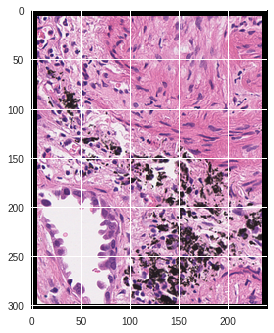

In [ ]:
imshow(this_item[0])

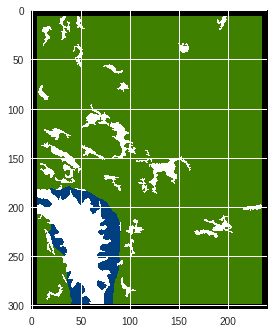

In [ ]:
plt.imshow(this_item[1])

In [ ]:
def pre_train(dataloader,model,optimizer,loss_function,EPOCHS):
  training_loss_compiled = list()  
  for epoch in range(EPOCHS):
      print(f"Epoch {epoch+1} of {EPOCHS}")
      train_epoch_loss = seg_train(
           dataloader, model, optimizer, loss_function
      )
      training_loss_compiled.append(train_epoch_loss)
  return training_loss_compiled


In [ ]:
pre_train(dataloader_segmentation_train,model, optim, criterion, 3)

Epoch 1 of 3


100%|██████████| 118/118 [01:59<00:00,  1.01s/it]


tensor(0.4001, device='cuda:0', grad_fn=<DivBackward0>)
Epoch 2 of 3


100%|██████████| 118/118 [01:59<00:00,  1.02s/it]


tensor(0.3565, device='cuda:0', grad_fn=<DivBackward0>)
Epoch 3 of 3


100%|██████████| 118/118 [01:59<00:00,  1.01s/it]

tensor(0.3404, device='cuda:0', grad_fn=<DivBackward0>)


[tensor(0.4001, device='cuda:0', grad_fn=<DivBackward0>),
 tensor(0.3565, device='cuda:0', grad_fn=<DivBackward0>),
 tensor(0.3404, device='cuda:0', grad_fn=<DivBackward0>)]

In [ ]:
torch.save({
              'epoch': 13,
              'model_state_dict': model.state_dict(),
              'optimizer_state_dict': optim.state_dict(),
              'loss': criterion,
              }, '/content/gdrive/MyDrive/deeplabplus_50_grid_second_before.pth')

## Predict multiclass masks

In [ ]:
training_y = np.array(training_y)

In [ ]:
class WSSS4LUAD_seg_new(Dataset):
  def __init__(self):
    self.x = np.array(non_single_class_images)
    self.n_samples =  self.x.shape[0]
    


  def __getitem__(self,index):
    image = self.x[index]
    toPIL = transforms.ToPILImage()
    image = toPIL(image)
    totens = transforms.ToTensor()
    image = totens(image)

    
    return image

  def __len__(self):
    return self.n_samples


In [ ]:
segmentation_new = WSSS4LUAD_seg_new()
dataloader_segmentation_new = DataLoader(dataset = segmentation_new, batch_size = 1, shuffle = False)

In [ ]:
def compose_pseudo_masks (dataloader, model):
  progress = tqdm(dataloader)  
  model.eval()
  all_predictions = list()
  
  for batch_idx, (data) in enumerate(progress):
    
    data = data.type(torch.FloatTensor)
    X = data.to(device)
    
    with torch.set_grad_enabled(False):
       predictions = model(X)
       # Create 4d from prediction
       p=predictions[:,:,:,:].detach().cpu()
       cpred=np.argmax(p,axis=1)
       all_predictions.append(cpred)
       
  
  

  return all_predictions

In [ ]:
predictions = compose_pseudo_masks(dataloader_segmentation_new, model)

100%|██████████| 5398/5398 [00:58<00:00, 91.87it/s]


([], <a list of 0 Text yticklabel objects>)

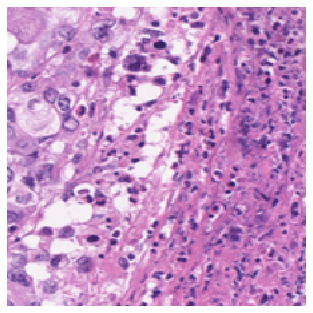

In [ ]:
plt.imshow(non_single_class_images[1])
plt.grid(None)

plt.xticks([])
plt.yticks([])

([], <a list of 0 Text yticklabel objects>)

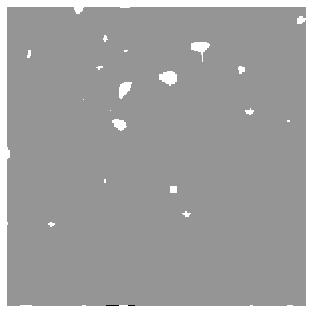

In [ ]:
plt.imshow(predictions[0].reshape(224,224))
plt.grid(None)
plt.xticks([])
plt.yticks([])

In [ ]:
def create_example(mask):
    mask = mask.numpy()
    this_mask = np.zeros((224,224,3),dtype=np.uint8)
    for i in range(len(mask)):
      for j in range(len(mask[0])):
        if mask[i][j] == 0:
          this_mask[i][j] = [255,255,255]
        elif mask[i][j] == 1:
          this_mask[i][j] = [0,64,128]
        elif mask[i][j] == 2:
          this_mask[i][j] = [64,128,0]
        elif mask[i][j] == 3:
          this_mask[i][j] = [243,152,0]
    
    return this_mask 

([], <a list of 0 Text yticklabel objects>)

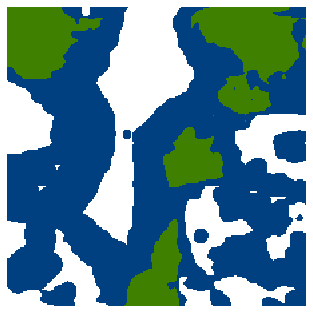

In [ ]:
plt.imshow(create_example(predictions[50].reshape(224,224)))
plt.grid(None)
plt.xticks([])
plt.yticks([])

In [ ]:
numpy_predictions = [prediction.numpy().reshape(224,224) for prediction in predictions]

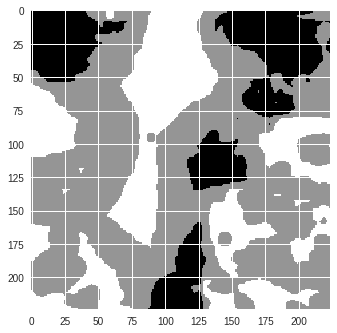

In [ ]:
plt.imshow(numpy_predictions[50])

In [ ]:
for i in range(len(non_single_class_images)):
  number = str(i)
  with open('/content/gdrive/MyDrive/predictions_of_multi_class_images_new/images/'+number+'.npy', 'wb') as f:
      np.save(f, non_single_class_images[i])
  with open('/content/gdrive/MyDrive/predictions_of_multi_class_images_new/masks/'+number+'.npy', 'wb') as f:
      np.save(f, numpy_predictions[i])

## Unzip images 

In [ ]:
!unzip "/content/gdrive/MyDrive/Whole_masks.zip" -d "/content"


Streaming output truncated to the last 5000 lines.
  inflating: /content/Whole_masks/masks/tumour/295.npy  
  inflating: /content/Whole_masks/masks/stroma/915.npy  
  inflating: /content/Whole_masks/masks/tumour/294.npy  
  inflating: /content/Whole_masks/images/tumour/147.npy  
  inflating: /content/Whole_masks/images/stroma/985.npy  
  inflating: /content/Whole_masks/images/tumour/138.npy  
  inflating: /content/Whole_masks/masks/stroma/914.npy  
  inflating: /content/Whole_masks/images/tumour/133.npy  
  inflating: /content/Whole_masks/masks/stroma/916.npy  
  inflating: /content/Whole_masks/masks/tumour/293.npy  
  inflating: /content/Whole_masks/images/tumour/130.npy  
  inflating: /content/Whole_masks/images/tumour/136.npy  
  inflating: /content/Whole_masks/masks/stroma/913.npy  
  inflating: /content/Whole_masks/images/tumour/140.npy  
  inflating: /content/Whole_masks/images/stroma/981.npy  
  inflating: /content/Whole_masks/images/stroma/979.npy  
  inflating: /content/Whole_

In [ ]:
tumour_i = list()
tumour_masks = list()

stroma_i = list()
stroma_masks = list()

normal_i = list()
normal_masks = list()
for i in range(len(only_tumour_i)):
  number = str(i)
  tumour_i.append(np.load('/content/Whole_masks/images/tumour/'+number+'.npy'))
  tumour_masks.append(np.load('/content/Whole_masks/masks/tumour/'+number+'.npy'))

for i in range(len(only_stroma_i)):
  number = str(i)
  stroma_i.append(np.load('/content/Whole_masks/images/stroma/'+number+'.npy'))
  stroma_masks.append(np.load('/content/Whole_masks/masks/stroma/'+number+'.npy'))

for i in range(len(only_normal_i)):
  number = str(i)
  normal_i.append(np.load('/content/Whole_masks/images/normal/'+number+'.npy'))
  normal_masks.append(np.load('/content/Whole_masks/masks/normal/'+number+'.npy'))

In [ ]:
def create_testing_masks(masks):
  new_masks = list()
  for mask in masks:
    this_mask = mask.copy()
    this_mask = this_mask[:, :,1]
    
    np.putmask(this_mask, this_mask == 0, 0)
    np.putmask(this_mask, this_mask == 255, 0)
    np.putmask(this_mask, this_mask == 64, 1)
    np.putmask(this_mask, this_mask == 128, 2)
    np.putmask(this_mask, this_mask == 152, 3)
    new_masks.append(this_mask)
  return new_masks 

In [ ]:
training_X = list()
training_y_new = list()

training_X.extend(tumour_i)
training_y_new.extend(tumour_masks)

training_X.extend(stroma_i)
training_y_new.extend(stroma_masks)


training_X.extend(normal_i)
training_y_new.extend(normal_masks)

In [ ]:
training_y_new = create_testing_masks(training_y_new)

In [ ]:
training_y_new[0]

array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1]], dtype=uint8)

In [ ]:
numpy_predictions = [mask.astype(np.uint8) for mask in numpy_predictions]

In [ ]:
training_X.extend(non_single_class_images)
training_y_new.extend(numpy_predictions)

In [ ]:
len(training_X)

10091

In [ ]:
len(training_y_new)

10091

In [ ]:
tumour_masks[0].shape

(224, 224, 3)

In [ ]:
# start the training and validation

def full_training_and_val(dataloaders, model,optimizer, loss_function, EPOCHS):
  train_loss_compiled = list()
  validation_IoUs_compiled = list()
  validation_cmatrix = list()
  best_tumour_accuracy = float('-inf')

  for epoch in range(EPOCHS):
      print(f"Epoch {epoch+1} of {EPOCHS}")
      train_epoch_loss = seg_train(
           dataloaders['train'], model, optimizer, loss_function
      )
      valid_epoch_metrics = seg_validate(
          dataloaders['val'], model, optimizer, loss_function
      )

      print(valid_epoch_metrics[0])

      if best_tumour_accuracy < valid_epoch_metrics[0]['IoU Tumour']:
        best_tumour_accuracy = valid_epoch_metrics[0]['IoU Tumour']
        torch.save({
              'epoch': EPOCHS,
              'model_state_dict': model.state_dict(),
              'optimizer_state_dict': optimizer.state_dict(),
              'loss': criterion,
              }, '/content/gdrive/MyDrive/deeplabplus_50_grid_second_after.pth')
        
      train_loss_compiled.append(train_epoch_loss)
      validation_IoUs_compiled.append(valid_epoch_metrics[0])
      validation_cmatrix.append(valid_epoch_metrics[1])




  return train_loss_compiled,validation_IoUs_compiled, validation_cmatrix, best_tumour_accuracy

In [ ]:
segmentation_train = WSSS4LUAD_seg_train()
dataloader_segmentation_train = DataLoader(dataset = segmentation_train, batch_size = 32, shuffle = True)
segmentation_valid = WSSS4LUAD_seg_valid(img_transform_valid,mask_transform_valid)
dataloader_segmentation_valid = DataLoader(dataset = segmentation_valid, batch_size = 1, shuffle = False)


In [ ]:
image,mask = segmentation_train.__getitem__(0)

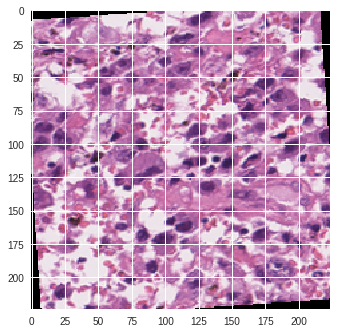

In [ ]:
imshow(image)

In [ ]:
dl = {'train':dataloader_segmentation_train,
               'val':dataloader_segmentation_valid}


In [ ]:
valid_epoch_metrics = seg_validate(
          dl['val'], model, optim, criterion
      )

  3%|▎         | 1/33 [00:00<00:05,  6.22it/s]

torch.Size([1, 496, 288])
torch.Size([1, 496, 288])
tensor([0.9084, 0.0000, 0.0000, 0.7967])
torch.Size([1, 288, 272])
torch.Size([1, 288, 272])
tensor([0.7769, 0.3532, 0.0436, 0.0000])


  9%|▉         | 3/33 [00:00<00:02, 10.54it/s]

torch.Size([1, 304, 352])
torch.Size([1, 304, 352])
tensor([0.4578, 0.7236, 0.0000, 0.0000])
torch.Size([1, 272, 256])
torch.Size([1, 272, 256])
tensor([0.5798, 0.0000, 0.5135, 0.0000])
torch.Size([1, 464, 400])
torch.Size([1, 464, 400])


 15%|█▌        | 5/33 [00:00<00:02, 10.63it/s]

tensor([0.7980, 0.3133, 0.6345, 0.0000])
torch.Size([1, 352, 224])
torch.Size([1, 352, 224])
tensor([0.8417, 0.0000, 0.0000, 0.8290])
torch.Size([1, 496, 480])
torch.Size([1, 496, 480])


 27%|██▋       | 9/33 [00:00<00:02, 10.82it/s]

tensor([0.6406, 0.4612, 0.1329, 0.0000])
torch.Size([1, 352, 256])
torch.Size([1, 352, 256])
tensor([0.3992, 0.5583, 0.0000, 0.0000])
torch.Size([1, 464, 256])
torch.Size([1, 464, 256])
tensor([0.8424, 0.0000, 0.0000, 0.8355])


 33%|███▎      | 11/33 [00:01<00:01, 11.47it/s]

torch.Size([1, 432, 288])
torch.Size([1, 432, 288])
tensor([0.7965, 0.0881, 0.3995, 0.0892])
torch.Size([1, 304, 240])
torch.Size([1, 304, 240])
tensor([0.7388, 0.1632, 0.7451, 0.0000])
torch.Size([1, 512, 368])
torch.Size([1, 512, 368])


 39%|███▉      | 13/33 [00:01<00:01, 10.23it/s]

tensor([0.8570, 0.2664, 0.3327, 0.0000])
torch.Size([1, 464, 320])
torch.Size([1, 464, 320])
tensor([0.8381, 0.3486, 0.1106, 0.0000])
torch.Size([1, 384, 432])
torch.Size([1, 384, 432])


 45%|████▌     | 15/33 [00:01<00:01, 10.24it/s]

tensor([6.7683e-01, 4.7570e-01, 3.3660e-04, 0.0000e+00])
torch.Size([1, 288, 352])
torch.Size([1, 288, 352])
tensor([0.6053, 0.4658, 0.0381, 0.0000])
torch.Size([1, 400, 320])
torch.Size([1, 400, 320])
tensor([0.8276, 0.0000, 0.9288, 0.0000])


 52%|█████▏    | 17/33 [00:01<00:01, 10.75it/s]

torch.Size([1, 240, 368])
torch.Size([1, 240, 368])
tensor([0.8193, 0.4947, 0.8816, 0.0000])
torch.Size([1, 400, 240])
torch.Size([1, 400, 240])
tensor([0.2181, 0.3706, 0.2164, 0.0000])
torch.Size([1, 480, 400])
torch.Size([1, 480, 400])


 64%|██████▎   | 21/33 [00:01<00:01, 10.93it/s]

tensor([0.7298, 0.0014, 0.0362, 0.0000])
torch.Size([1, 352, 240])
torch.Size([1, 352, 240])
tensor([0.6754, 0.6852, 0.0073, 0.0000])
torch.Size([1, 496, 256])
torch.Size([1, 496, 256])
tensor([0.6606, 0.3091, 0.2555, 0.0000])
torch.Size([1, 240, 288])
torch.Size([1, 240, 288])


 70%|██████▉   | 23/33 [00:02<00:00, 12.19it/s]

tensor([0.7565, 0.4860, 0.3300, 0.0000])
torch.Size([1, 352, 256])
torch.Size([1, 352, 256])
tensor([0.7021, 0.4583, 0.0157, 0.0000])
torch.Size([1, 480, 224])
torch.Size([1, 480, 224])
tensor([0.5246, 0.6070, 0.3224, 0.0000])
torch.Size([1, 512, 336])
torch.Size([1, 512, 336])


 82%|████████▏ | 27/33 [00:02<00:00, 11.33it/s]

tensor([0.8166, 0.4994, 0.4821, 0.0000])
torch.Size([1, 208, 256])
torch.Size([1, 208, 256])
tensor([0.7395, 0.7124, 0.0102, 0.0000])
torch.Size([1, 432, 480])
torch.Size([1, 432, 480])
tensor([0.7771, 0.6481, 0.0010, 0.0000])


 88%|████████▊ | 29/33 [00:02<00:00, 12.03it/s]

torch.Size([1, 256, 304])
torch.Size([1, 256, 304])
tensor([0.8403, 0.6599, 0.0565, 0.0000])
torch.Size([1, 352, 352])
torch.Size([1, 352, 352])
tensor([0.7328, 0.4944, 0.7199, 0.0000])
torch.Size([1, 240, 480])
torch.Size([1, 240, 480])
tensor([0.3914, 0.8890, 0.6832, 0.0000])


 94%|█████████▍| 31/33 [00:02<00:00, 11.49it/s]

torch.Size([1, 336, 496])
torch.Size([1, 336, 496])
tensor([0.7810, 0.7978, 0.2771, 0.0000])
torch.Size([1, 1584, 1344])
torch.Size([1, 1584, 1344])
tensor([0.8289, 0.5364, 0.1496, 0.0000])
torch.Size([1, 1728, 1728])
torch.Size([1, 1728, 1728])
tensor([0.4993, 0.4195, 0.1103, 0.0000])


100%|██████████| 33/33 [00:05<00:00,  5.63it/s]


In [ ]:
valid_epoch_metrics

({'Accuracy': 0.672687266035111,
  'IoU Background': tensor(0.5884),
  'IoU Normal': tensor(0.2836),
  'IoU Stroma': tensor(0.4999),
  'IoU Tumour': tensor(0.4402)},
 array([[1443581.,  276713.,  518360.,   43374.],
        [  13400., 2102677.,  398419.,   32920.],
        [   7058.,  961654., 2373037.,   21837.],
        [  14147.,    8547.,  624646.,   84046.]]))

In [ ]:
optim = torch.optim.Adam(model.parameters(), lr=0.003) # Adam is going to be the most robust


In [ ]:
train_val = full_training_and_val(dl,model, optim, criterion, 9)

Epoch 1 of 9


100%|██████████| 316/316 [05:17<00:00,  1.00s/it]


tensor(0.3118, device='cuda:0', grad_fn=<DivBackward0>)


  6%|▌         | 2/33 [00:00<00:02, 13.42it/s]

torch.Size([1, 496, 288])
torch.Size([1, 496, 288])
tensor([0.7927, 0.0000, 0.0000, 0.6655])
torch.Size([1, 288, 272])
torch.Size([1, 288, 272])
tensor([0.6770, 0.5389, 0.6172, 0.0000])
torch.Size([1, 304, 352])
torch.Size([1, 304, 352])
tensor([0.5275, 0.4269, 0.3383, 0.0000])


 12%|█▏        | 4/33 [00:00<00:01, 15.08it/s]

torch.Size([1, 272, 256])
torch.Size([1, 272, 256])
tensor([0.2982, 0.0000, 0.0000, 0.0000])
torch.Size([1, 464, 400])
torch.Size([1, 464, 400])
tensor([0.6072, 0.0000, 0.0000, 0.0000])
torch.Size([1, 352, 224])
torch.Size([1, 352, 224])
tensor([0.6606, 0.0000, 0.0000, 0.7939])


 18%|█▊        | 6/33 [00:00<00:02, 13.44it/s]

torch.Size([1, 496, 480])
torch.Size([1, 496, 480])
tensor([0.5520, 0.5123, 0.4523, 0.0000])
torch.Size([1, 352, 256])
torch.Size([1, 352, 256])
tensor([0.4334, 0.5859, 0.2071, 0.0000])


 24%|██▍       | 8/33 [00:00<00:02, 11.92it/s]

torch.Size([1, 464, 256])
torch.Size([1, 464, 256])


 30%|███       | 10/33 [00:00<00:01, 12.29it/s]

tensor([0.6839, 0.0000, 0.0000, 0.7519])
torch.Size([1, 432, 288])
torch.Size([1, 432, 288])
tensor([0.5817, 0.0000, 0.0000, 0.3001])
torch.Size([1, 304, 240])
torch.Size([1, 304, 240])
tensor([0.6810, 0.0000, 0.0674, 0.0000])
torch.Size([1, 512, 368])
torch.Size([1, 512, 368])


 36%|███▋      | 12/33 [00:00<00:01, 12.14it/s]

tensor([0.7261, 0.0000, 0.0000, 0.0000])
torch.Size([1, 464, 320])
torch.Size([1, 464, 320])
tensor([7.4739e-01, 4.2723e-04, 1.2765e-01, 0.0000e+00])
torch.Size([1, 384, 432])
torch.Size([1, 384, 432])


 42%|████▏     | 14/33 [00:01<00:01, 11.29it/s]

tensor([0.5282, 0.0000, 0.0007, 0.0000])
torch.Size([1, 288, 352])
torch.Size([1, 288, 352])
tensor([0.4088, 0.0485, 0.0439, 0.0000])
torch.Size([1, 400, 320])
torch.Size([1, 400, 320])


 48%|████▊     | 16/33 [00:01<00:01, 12.03it/s]

tensor([0.7691, 0.0000, 0.9101, 0.0000])
torch.Size([1, 240, 368])
torch.Size([1, 240, 368])


 55%|█████▍    | 18/33 [00:01<00:01, 13.10it/s]

tensor([0.7051, 0.0000, 0.8340, 0.0000])
torch.Size([1, 400, 240])
torch.Size([1, 400, 240])
tensor([0.1350, 0.0000, 0.2032, 0.0000])
torch.Size([1, 480, 400])
torch.Size([1, 480, 400])
tensor([0.4514, 0.0000, 0.0000, 0.0000])


 67%|██████▋   | 22/33 [00:01<00:00, 13.34it/s]

torch.Size([1, 352, 240])
torch.Size([1, 352, 240])
tensor([0.6526, 0.7261, 0.3436, 0.0000])
torch.Size([1, 496, 256])
torch.Size([1, 496, 256])
tensor([0.3681, 0.0201, 0.0000, 0.0000])
torch.Size([1, 240, 288])
torch.Size([1, 240, 288])
tensor([0.5337, 0.0000, 0.0000, 0.0000])
torch.Size([1, 352, 256])
torch.Size([1, 352, 256])


 73%|███████▎  | 24/33 [00:01<00:00, 13.82it/s]

tensor([0.6343, 0.3617, 0.4072, 0.0000])
torch.Size([1, 480, 224])
torch.Size([1, 480, 224])
tensor([0.2278, 0.0000, 0.0000, 0.0000])
torch.Size([1, 512, 336])
torch.Size([1, 512, 336])
tensor([0.7752, 0.5623, 0.8370, 0.0000])


 79%|███████▉  | 26/33 [00:02<00:00, 13.24it/s]

torch.Size([1, 208, 256])
torch.Size([1, 208, 256])
tensor([0.7054, 0.5931, 0.4483, 0.0000])
torch.Size([1, 432, 480])
torch.Size([1, 432, 480])
tensor([0.5920, 0.4402, 0.0639, 0.0000])
torch.Size([1, 256, 304])
torch.Size([1, 256, 304])


 91%|█████████ | 30/33 [00:02<00:00, 12.22it/s]

tensor([0.7979, 0.7212, 0.6441, 0.0000])
torch.Size([1, 352, 352])
torch.Size([1, 352, 352])
tensor([0.6157, 0.0000, 0.6991, 0.0000])
torch.Size([1, 240, 480])
torch.Size([1, 240, 480])
tensor([0.1748, 0.3169, 0.0980, 0.0000])
torch.Size([1, 336, 496])
torch.Size([1, 336, 496])
tensor([0.6297, 0.3091, 0.2097, 0.0000])
torch.Size([1, 1584, 1344])
torch.Size([1, 1584, 1344])


 97%|█████████▋| 32/33 [00:03<00:00,  3.68it/s]

tensor([0.6260, 0.0000, 0.0000, 0.3314])
torch.Size([1, 1728, 1728])
torch.Size([1, 1728, 1728])
tensor([0.3058, 0.0000, 0.5630, 0.0000])


100%|██████████| 33/33 [00:05<00:00,  6.03it/s]


{'Accuracy': 0.5132878162559881, 'IoU Tumour': tensor(0.2125), 'IoU Stroma': tensor(0.2705), 'IoU Normal': tensor(0.5686), 'IoU Background': tensor(0.5638)}
Epoch 2 of 9


100%|██████████| 316/316 [05:18<00:00,  1.01s/it]


tensor(0.2860, device='cuda:0', grad_fn=<DivBackward0>)


  6%|▌         | 2/33 [00:00<00:02, 13.86it/s]

torch.Size([1, 496, 288])
torch.Size([1, 496, 288])
tensor([0.8269, 0.0000, 0.0000, 0.7031])
torch.Size([1, 288, 272])
torch.Size([1, 288, 272])
tensor([0.7644, 0.3989, 0.1599, 0.0000])
torch.Size([1, 304, 352])
torch.Size([1, 304, 352])
tensor([0.5201, 0.7278, 0.0160, 0.0000])
torch.Size([1, 272, 256])
torch.Size([1, 272, 256])


 12%|█▏        | 4/33 [00:00<00:01, 15.97it/s]

tensor([0.5037, 0.0000, 0.8652, 0.0000])
torch.Size([1, 464, 400])
torch.Size([1, 464, 400])
tensor([0.7544, 0.1464, 0.1210, 0.0000])
torch.Size([1, 352, 224])
torch.Size([1, 352, 224])


 18%|█▊        | 6/33 [00:00<00:01, 13.98it/s]

tensor([0.7200, 0.0000, 0.0000, 0.8230])


 24%|██▍       | 8/33 [00:00<00:02, 12.41it/s]

torch.Size([1, 496, 480])
torch.Size([1, 496, 480])
tensor([0.6150, 0.4332, 0.0509, 0.0000])
torch.Size([1, 352, 256])
torch.Size([1, 352, 256])
tensor([0.5655, 0.5917, 0.0000, 0.0000])
torch.Size([1, 464, 256])
torch.Size([1, 464, 256])


 30%|███       | 10/33 [00:00<00:01, 12.80it/s]

tensor([0.7622, 0.0000, 0.0000, 0.7967])
torch.Size([1, 432, 288])
torch.Size([1, 432, 288])
tensor([0.7183, 0.0000, 0.0000, 0.3232])
torch.Size([1, 304, 240])
torch.Size([1, 304, 240])
tensor([0.7495, 0.1333, 0.7162, 0.0000])
torch.Size([1, 512, 368])
torch.Size([1, 512, 368])


 36%|███▋      | 12/33 [00:00<00:01, 12.41it/s]

tensor([0.8433, 0.2170, 0.1168, 0.0000])
torch.Size([1, 464, 320])
torch.Size([1, 464, 320])
tensor([0.7849, 0.3349, 0.1251, 0.0000])
torch.Size([1, 384, 432])
torch.Size([1, 384, 432])
tensor([0.5634, 0.4879, 0.1510, 0.0000])


 42%|████▏     | 14/33 [00:01<00:01, 11.53it/s]

torch.Size([1, 288, 352])
torch.Size([1, 288, 352])
tensor([0.4858, 0.4637, 0.1068, 0.0000])
torch.Size([1, 400, 320])
torch.Size([1, 400, 320])


 48%|████▊     | 16/33 [00:01<00:01, 12.04it/s]

tensor([0.8432, 0.0000, 0.8574, 0.0000])
torch.Size([1, 240, 368])
torch.Size([1, 240, 368])
tensor([0.8093, 0.0107, 0.8642, 0.0000])


 55%|█████▍    | 18/33 [00:01<00:01, 13.18it/s]

torch.Size([1, 400, 240])
torch.Size([1, 400, 240])
tensor([0.1741, 0.0000, 0.2084, 0.0000])
torch.Size([1, 480, 400])
torch.Size([1, 480, 400])
tensor([0.5820, 0.0000, 0.0000, 0.0000])
torch.Size([1, 352, 240])
torch.Size([1, 352, 240])
tensor([0.7015, 0.6970, 0.0627, 0.0000])


 67%|██████▋   | 22/33 [00:01<00:00, 13.63it/s]

torch.Size([1, 496, 256])
torch.Size([1, 496, 256])
tensor([0.4751, 0.1181, 0.0201, 0.0000])
torch.Size([1, 240, 288])
torch.Size([1, 240, 288])
tensor([0.7187, 0.4219, 0.0959, 0.0000])
torch.Size([1, 352, 256])
torch.Size([1, 352, 256])
tensor([0.6777, 0.4536, 0.0300, 0.0000])
torch.Size([1, 480, 224])
torch.Size([1, 480, 224])


 73%|███████▎  | 24/33 [00:01<00:00, 14.38it/s]

tensor([0.3304, 0.2790, 0.1797, 0.0000])
torch.Size([1, 512, 336])
torch.Size([1, 512, 336])


 79%|███████▉  | 26/33 [00:01<00:00, 13.88it/s]

tensor([0.8028, 0.6223, 0.7148, 0.0000])
torch.Size([1, 208, 256])
torch.Size([1, 208, 256])
tensor([0.7717, 0.8601, 0.7700, 0.0000])
torch.Size([1, 432, 480])
torch.Size([1, 432, 480])
tensor([0.6144, 0.6195, 0.0585, 0.0000])


 85%|████████▍ | 28/33 [00:02<00:00, 12.72it/s]

torch.Size([1, 256, 304])
torch.Size([1, 256, 304])
tensor([0.8310, 0.7428, 0.5108, 0.0000])
torch.Size([1, 352, 352])
torch.Size([1, 352, 352])


 91%|█████████ | 30/33 [00:02<00:00, 12.63it/s]

tensor([0.7178, 0.4770, 0.8087, 0.0000])
torch.Size([1, 240, 480])
torch.Size([1, 240, 480])
tensor([0.3915, 0.8475, 0.4777, 0.0000])
torch.Size([1, 336, 496])
torch.Size([1, 336, 496])
tensor([0.7356, 0.7698, 0.3980, 0.0000])
torch.Size([1, 1584, 1344])
torch.Size([1, 1584, 1344])


 97%|█████████▋| 32/33 [00:03<00:00,  3.68it/s]

tensor([0.8034, 0.6337, 0.3842, 0.5261])
torch.Size([1, 1728, 1728])
torch.Size([1, 1728, 1728])
tensor([0.4952, 0.4527, 0.3731, 0.0000])


100%|██████████| 33/33 [00:05<00:00,  6.01it/s]


{'Accuracy': 0.6541892489099567, 'IoU Tumour': tensor(0.4118), 'IoU Stroma': tensor(0.3081), 'IoU Normal': tensor(0.6344), 'IoU Background': tensor(0.6561)}
Epoch 3 of 9


100%|██████████| 316/316 [05:18<00:00,  1.01s/it]


tensor(0.2794, device='cuda:0', grad_fn=<DivBackward0>)


  6%|▌         | 2/33 [00:00<00:02, 13.66it/s]

torch.Size([1, 496, 288])
torch.Size([1, 496, 288])
tensor([0.8320, 0.0000, 0.0000, 0.7097])
torch.Size([1, 288, 272])
torch.Size([1, 288, 272])
tensor([0.7199, 0.4448, 0.3755, 0.0000])
torch.Size([1, 304, 352])
torch.Size([1, 304, 352])
tensor([0.5265, 0.7285, 0.0194, 0.0000])
torch.Size([1, 272, 256])
torch.Size([1, 272, 256])


 12%|█▏        | 4/33 [00:00<00:01, 15.45it/s]

tensor([0.4232, 0.0000, 0.0000, 0.0000])
torch.Size([1, 464, 400])
torch.Size([1, 464, 400])
tensor([0.7157, 0.0061, 0.0000, 0.0000])
torch.Size([1, 352, 224])
torch.Size([1, 352, 224])


 18%|█▊        | 6/33 [00:00<00:01, 13.90it/s]

tensor([0.7337, 0.0000, 0.0000, 0.8302])
torch.Size([1, 496, 480])
torch.Size([1, 496, 480])
tensor([0.5960, 0.4910, 0.3171, 0.0000])
torch.Size([1, 352, 256])
torch.Size([1, 352, 256])


 24%|██▍       | 8/33 [00:00<00:02, 11.99it/s]

tensor([0.4856, 0.5779, 0.0025, 0.0000])
torch.Size([1, 464, 256])
torch.Size([1, 464, 256])
tensor([0.7550, 0.0000, 0.0000, 0.7934])
torch.Size([1, 432, 288])
torch.Size([1, 432, 288])


 30%|███       | 10/33 [00:00<00:01, 12.46it/s]

tensor([0.6910, 0.0000, 0.0000, 0.3179])
torch.Size([1, 304, 240])
torch.Size([1, 304, 240])


 36%|███▋      | 12/33 [00:00<00:01, 12.26it/s]

tensor([0.7324, 0.4588, 0.9229, 0.0000])
torch.Size([1, 512, 368])
torch.Size([1, 512, 368])
tensor([0.8120, 0.0000, 0.0000, 0.0000])
torch.Size([1, 464, 320])
torch.Size([1, 464, 320])


 42%|████▏     | 14/33 [00:01<00:01, 11.39it/s]

tensor([0.8066, 0.3994, 0.3053, 0.0000])
torch.Size([1, 384, 432])
torch.Size([1, 384, 432])
tensor([0.6150, 0.5136, 0.2098, 0.0000])
torch.Size([1, 288, 352])
torch.Size([1, 288, 352])
tensor([0.5040, 0.5685, 0.4839, 0.0000])
torch.Size([1, 400, 320])
torch.Size([1, 400, 320])


 48%|████▊     | 16/33 [00:01<00:01, 11.94it/s]

tensor([0.7864, 0.0000, 0.9146, 0.0000])
torch.Size([1, 240, 368])
torch.Size([1, 240, 368])
tensor([0.7415, 0.0000, 0.8417, 0.0000])
torch.Size([1, 400, 240])
torch.Size([1, 400, 240])
tensor([0.1487, 0.0000, 0.2045, 0.0000])


 55%|█████▍    | 18/33 [00:01<00:01, 13.17it/s]

torch.Size([1, 480, 400])
torch.Size([1, 480, 400])


 61%|██████    | 20/33 [00:01<00:01, 12.57it/s]

tensor([0.5809, 0.0000, 0.0000, 0.0000])
torch.Size([1, 352, 240])
torch.Size([1, 352, 240])
tensor([0.6833, 0.7068, 0.1334, 0.0000])
torch.Size([1, 496, 256])
torch.Size([1, 496, 256])


 67%|██████▋   | 22/33 [00:01<00:00, 13.44it/s]

tensor([0.4482, 0.5312, 0.0000, 0.0000])
torch.Size([1, 240, 288])
torch.Size([1, 240, 288])
tensor([0.6610, 0.0000, 0.0000, 0.0000])


 73%|███████▎  | 24/33 [00:01<00:00, 14.04it/s]

torch.Size([1, 352, 256])
torch.Size([1, 352, 256])
tensor([0.6858, 0.5067, 0.2746, 0.0000])
torch.Size([1, 480, 224])
torch.Size([1, 480, 224])
tensor([0.3001, 0.0235, 0.0000, 0.0000])
torch.Size([1, 512, 336])
torch.Size([1, 512, 336])


 79%|███████▉  | 26/33 [00:02<00:00, 13.59it/s]

tensor([0.7901, 0.7308, 0.8390, 0.0000])
torch.Size([1, 208, 256])
torch.Size([1, 208, 256])
tensor([0.7281, 0.8393, 0.7166, 0.0000])
torch.Size([1, 432, 480])
torch.Size([1, 432, 480])
tensor([0.6038, 0.6259, 0.1118, 0.0000])


 85%|████████▍ | 28/33 [00:02<00:00, 12.51it/s]

torch.Size([1, 256, 304])
torch.Size([1, 256, 304])
tensor([0.8165, 0.7584, 0.5848, 0.0000])
torch.Size([1, 352, 352])
torch.Size([1, 352, 352])
tensor([0.6565, 0.5593, 0.8238, 0.0000])
torch.Size([1, 240, 480])
torch.Size([1, 240, 480])


 91%|█████████ | 30/33 [00:02<00:00, 12.54it/s]

tensor([0.1647, 0.8538, 0.6255, 0.0000])
torch.Size([1, 336, 496])
torch.Size([1, 336, 496])
tensor([0.6408, 0.7880, 0.3928, 0.0000])
torch.Size([1, 1584, 1344])
torch.Size([1, 1584, 1344])


 97%|█████████▋| 32/33 [00:03<00:00,  3.77it/s]

tensor([0.7448, 0.0000, 0.0000, 0.3468])
torch.Size([1, 1728, 1728])
torch.Size([1, 1728, 1728])
tensor([0.3828, 0.0030, 0.5689, 0.0000])


100%|██████████| 33/33 [00:05<00:00,  5.95it/s]


{'Accuracy': 0.5824406885559794, 'IoU Tumour': tensor(0.3833), 'IoU Stroma': tensor(0.3223), 'IoU Normal': tensor(0.5996), 'IoU Background': tensor(0.6216)}
Epoch 4 of 9


100%|██████████| 316/316 [05:18<00:00,  1.01s/it]


tensor(0.2665, device='cuda:0', grad_fn=<DivBackward0>)


  3%|▎         | 1/33 [00:00<00:03, 10.00it/s]

torch.Size([1, 496, 288])
torch.Size([1, 496, 288])
tensor([0.8532, 0.0000, 0.0000, 0.7361])
torch.Size([1, 288, 272])
torch.Size([1, 288, 272])
tensor([0.7062, 0.3635, 0.0449, 0.0000])
torch.Size([1, 304, 352])
torch.Size([1, 304, 352])


  9%|▉         | 3/33 [00:00<00:02, 14.25it/s]

tensor([0.5005, 0.7267, 0.0051, 0.0000])


 15%|█▌        | 5/33 [00:00<00:02, 13.49it/s]

torch.Size([1, 272, 256])
torch.Size([1, 272, 256])
tensor([0.4406, 0.0000, 0.0018, 0.0000])
torch.Size([1, 464, 400])
torch.Size([1, 464, 400])
tensor([0.6769, 0.1334, 0.0397, 0.0000])
torch.Size([1, 352, 224])
torch.Size([1, 352, 224])
tensor([0.7417, 0.0000, 0.0000, 0.8342])


 21%|██        | 7/33 [00:00<00:02, 11.75it/s]

torch.Size([1, 496, 480])
torch.Size([1, 496, 480])
tensor([0.4046, 0.6014, 0.0286, 0.0000])
torch.Size([1, 352, 256])
torch.Size([1, 352, 256])
tensor([0.4871, 0.5401, 0.0408, 0.0000])
torch.Size([1, 464, 256])
torch.Size([1, 464, 256])


 27%|██▋       | 9/33 [00:00<00:01, 12.67it/s]

tensor([0.7547, 0.0000, 0.0000, 0.7928])
torch.Size([1, 432, 288])
torch.Size([1, 432, 288])
tensor([0.7436, 0.0659, 0.0027, 0.3670])
torch.Size([1, 304, 240])
torch.Size([1, 304, 240])
tensor([0.7400, 0.0546, 0.2360, 0.0000])


 33%|███▎      | 11/33 [00:00<00:01, 13.66it/s]

torch.Size([1, 512, 368])
torch.Size([1, 512, 368])


 39%|███▉      | 13/33 [00:01<00:01, 12.27it/s]

tensor([0.8025, 0.2002, 0.0395, 0.0000])
torch.Size([1, 464, 320])
torch.Size([1, 464, 320])
tensor([0.7772, 0.3112, 0.0028, 0.0000])
torch.Size([1, 384, 432])
torch.Size([1, 384, 432])
tensor([0.5731, 0.5219, 0.0436, 0.0000])


 45%|████▌     | 15/33 [00:01<00:01, 12.02it/s]

torch.Size([1, 288, 352])
torch.Size([1, 288, 352])
tensor([0.3137, 0.5777, 0.1479, 0.0000])
torch.Size([1, 400, 320])
torch.Size([1, 400, 320])
tensor([7.8542e-01, 0.0000e+00, 2.8046e-04, 0.0000e+00])
torch.Size([1, 240, 368])
torch.Size([1, 240, 368])
tensor([0.7908, 0.1976, 0.7675, 0.0000])


 52%|█████▏    | 17/33 [00:01<00:01, 12.80it/s]

torch.Size([1, 400, 240])
torch.Size([1, 400, 240])


 58%|█████▊    | 19/33 [00:01<00:01, 12.45it/s]

tensor([0.1755, 0.1058, 0.4770, 0.0000])
torch.Size([1, 480, 400])
torch.Size([1, 480, 400])
tensor([0.5881, 0.0000, 0.0000, 0.0000])
torch.Size([1, 352, 240])
torch.Size([1, 352, 240])
tensor([0.5791, 0.6830, 0.0523, 0.0000])
torch.Size([1, 496, 256])
torch.Size([1, 496, 256])


 70%|██████▉   | 23/33 [00:01<00:00, 14.38it/s]

tensor([0.4281, 0.1109, 0.0000, 0.0000])
torch.Size([1, 240, 288])
torch.Size([1, 240, 288])
tensor([0.6469, 0.4021, 0.0450, 0.0000])
torch.Size([1, 352, 256])
torch.Size([1, 352, 256])
tensor([6.2269e-01, 4.4053e-01, 2.4980e-04, 0.0000e+00])
torch.Size([1, 480, 224])
torch.Size([1, 480, 224])
tensor([0.2681, 0.2508, 0.0500, 0.0000])


 76%|███████▌  | 25/33 [00:01<00:00, 13.12it/s]

torch.Size([1, 512, 336])
torch.Size([1, 512, 336])
tensor([0.7479, 0.5699, 0.6433, 0.0000])
torch.Size([1, 208, 256])
torch.Size([1, 208, 256])
tensor([0.6757, 0.8110, 0.6043, 0.0000])
torch.Size([1, 432, 480])
torch.Size([1, 432, 480])


 82%|████████▏ | 27/33 [00:02<00:00, 12.51it/s]

tensor([0.6689, 0.6895, 0.1251, 0.0000])
torch.Size([1, 256, 304])
torch.Size([1, 256, 304])
tensor([0.8073, 0.6956, 0.3030, 0.0000])


 88%|████████▊ | 29/33 [00:02<00:00, 13.02it/s]

torch.Size([1, 352, 352])
torch.Size([1, 352, 352])
tensor([0.6587, 0.4399, 0.7340, 0.0000])
torch.Size([1, 240, 480])
torch.Size([1, 240, 480])
tensor([0.2239, 0.7641, 0.3222, 0.0000])
torch.Size([1, 336, 496])
torch.Size([1, 336, 496])


 94%|█████████▍| 31/33 [00:02<00:00, 12.19it/s]

tensor([0.6923, 0.7563, 0.4012, 0.0000])
torch.Size([1, 1584, 1344])
torch.Size([1, 1584, 1344])
tensor([0.7920, 0.3446, 0.0993, 0.0024])
torch.Size([1, 1728, 1728])
torch.Size([1, 1728, 1728])
tensor([0.4265, 0.4000, 0.1675, 0.0000])


100%|██████████| 33/33 [00:05<00:00,  6.10it/s]


{'Accuracy': 0.5321139220762457, 'IoU Tumour': tensor(0.4055), 'IoU Stroma': tensor(0.1808), 'IoU Normal': tensor(0.5465), 'IoU Background': tensor(0.6089)}
Epoch 5 of 9


100%|██████████| 316/316 [05:18<00:00,  1.01s/it]


tensor(0.2522, device='cuda:0', grad_fn=<DivBackward0>)


  6%|▌         | 2/33 [00:00<00:02, 14.00it/s]

torch.Size([1, 496, 288])
torch.Size([1, 496, 288])
tensor([0.7658, 0.0000, 0.0000, 0.0000])
torch.Size([1, 288, 272])
torch.Size([1, 288, 272])
tensor([0.4328, 0.3343, 0.0470, 0.0000])
torch.Size([1, 304, 352])
torch.Size([1, 304, 352])
tensor([0.5016, 0.7268, 0.0163, 0.0000])
torch.Size([1, 272, 256])
torch.Size([1, 272, 256])


 12%|█▏        | 4/33 [00:00<00:01, 15.70it/s]

tensor([0.2981, 0.0000, 0.8260, 0.0000])
torch.Size([1, 464, 400])
torch.Size([1, 464, 400])
tensor([0.4802, 0.1228, 0.0353, 0.0000])
torch.Size([1, 352, 224])
torch.Size([1, 352, 224])


 18%|█▊        | 6/33 [00:00<00:01, 13.92it/s]

tensor([0.6863, 0.0000, 0.0000, 0.7538])


 24%|██▍       | 8/33 [00:00<00:02, 12.23it/s]

torch.Size([1, 496, 480])
torch.Size([1, 496, 480])
tensor([0.2655, 0.3847, 0.0343, 0.0000])
torch.Size([1, 352, 256])
torch.Size([1, 352, 256])
tensor([0.1408, 0.5165, 0.0000, 0.0000])
torch.Size([1, 464, 256])
torch.Size([1, 464, 256])


 30%|███       | 10/33 [00:00<00:01, 12.43it/s]

tensor([0.6602, 0.0000, 0.0000, 0.0000])
torch.Size([1, 432, 288])
torch.Size([1, 432, 288])
tensor([0.5748, 0.0738, 0.3966, 0.0000])
torch.Size([1, 304, 240])
torch.Size([1, 304, 240])
tensor([0.6765, 0.0621, 0.3397, 0.0000])
torch.Size([1, 512, 368])
torch.Size([1, 512, 368])


 36%|███▋      | 12/33 [00:00<00:01, 12.30it/s]

tensor([0.7038, 0.1901, 0.0469, 0.0000])
torch.Size([1, 464, 320])
torch.Size([1, 464, 320])
tensor([0.6478, 0.2992, 0.0546, 0.0000])
torch.Size([1, 384, 432])
torch.Size([1, 384, 432])
tensor([0.2697, 0.4336, 0.0884, 0.0000])


 42%|████▏     | 14/33 [00:01<00:01, 11.63it/s]

torch.Size([1, 288, 352])
torch.Size([1, 288, 352])
tensor([0.0741, 0.4141, 0.0396, 0.0000])
torch.Size([1, 400, 320])
torch.Size([1, 400, 320])


 48%|████▊     | 16/33 [00:01<00:01, 12.16it/s]

tensor([0.7048, 0.0000, 0.8858, 0.0000])
torch.Size([1, 240, 368])
torch.Size([1, 240, 368])
tensor([0.5943, 0.0000, 0.8025, 0.0000])


 55%|█████▍    | 18/33 [00:01<00:01, 13.30it/s]

torch.Size([1, 400, 240])
torch.Size([1, 400, 240])
tensor([0.1288, 0.0000, 0.2055, 0.0000])
torch.Size([1, 480, 400])
torch.Size([1, 480, 400])
tensor([0.4374, 0.0000, 0.7302, 0.0000])
torch.Size([1, 352, 240])
torch.Size([1, 352, 240])


 67%|██████▋   | 22/33 [00:01<00:00, 13.77it/s]

tensor([0.5258, 0.6647, 0.0382, 0.0000])
torch.Size([1, 496, 256])
torch.Size([1, 496, 256])
tensor([0.2228, 0.0960, 0.0100, 0.0000])
torch.Size([1, 240, 288])
torch.Size([1, 240, 288])
tensor([0.5321, 0.3777, 0.0118, 0.0000])
torch.Size([1, 352, 256])
torch.Size([1, 352, 256])
tensor([0.5366, 0.4273, 0.0063, 0.0000])
torch.Size([1, 480, 224])
torch.Size([1, 480, 224])


 73%|███████▎  | 24/33 [00:01<00:00, 14.50it/s]

tensor([0.1553, 0.2344, 0.0753, 0.0000])
torch.Size([1, 512, 336])
torch.Size([1, 512, 336])


 79%|███████▉  | 26/33 [00:01<00:00, 13.91it/s]

tensor([0.6363, 0.5730, 0.6890, 0.0000])
torch.Size([1, 208, 256])
torch.Size([1, 208, 256])
tensor([0.5532, 0.7634, 0.6848, 0.0000])
torch.Size([1, 432, 480])
torch.Size([1, 432, 480])
tensor([0.3464, 0.5604, 0.0520, 0.0000])


 85%|████████▍ | 28/33 [00:02<00:00, 12.74it/s]

torch.Size([1, 256, 304])
torch.Size([1, 256, 304])
tensor([0.6672, 0.6731, 0.4801, 0.0000])
torch.Size([1, 352, 352])
torch.Size([1, 352, 352])


 91%|█████████ | 30/33 [00:02<00:00, 12.66it/s]

tensor([0.5480, 0.3610, 0.7873, 0.0000])
torch.Size([1, 240, 480])
torch.Size([1, 240, 480])
tensor([0.1394, 0.7322, 0.2906, 0.0000])
torch.Size([1, 336, 496])
torch.Size([1, 336, 496])
tensor([0.3883, 0.6501, 0.3889, 0.0000])
torch.Size([1, 1584, 1344])
torch.Size([1, 1584, 1344])


 97%|█████████▋| 32/33 [00:03<00:00,  3.80it/s]

tensor([0.6417, 0.3120, 0.1742, 0.0000])
torch.Size([1, 1728, 1728])
torch.Size([1, 1728, 1728])
tensor([0.2715, 0.4442, 0.4287, 0.0000])


100%|██████████| 33/33 [00:05<00:00,  6.08it/s]


{'Accuracy': 0.5556084566205788, 'IoU Tumour': tensor(0.3596), 'IoU Stroma': tensor(0.2889), 'IoU Normal': tensor(0.1508), 'IoU Background': tensor(0.4608)}
Epoch 6 of 9


100%|██████████| 316/316 [05:17<00:00,  1.01s/it]


tensor(0.2505, device='cuda:0', grad_fn=<DivBackward0>)


  6%|▌         | 2/33 [00:00<00:02, 14.11it/s]

torch.Size([1, 496, 288])
torch.Size([1, 496, 288])
tensor([0.8405, 0.0000, 0.0000, 0.7199])
torch.Size([1, 288, 272])
torch.Size([1, 288, 272])
tensor([0.7493, 0.3769, 0.0943, 0.0000])
torch.Size([1, 304, 352])
torch.Size([1, 304, 352])
tensor([0.5305, 0.7278, 0.0164, 0.0000])
torch.Size([1, 272, 256])
torch.Size([1, 272, 256])


 12%|█▏        | 4/33 [00:00<00:01, 15.89it/s]

tensor([0.4304, 0.0000, 0.8498, 0.0000])
torch.Size([1, 464, 400])
torch.Size([1, 464, 400])
tensor([0.7391, 0.1478, 0.1460, 0.0000])
torch.Size([1, 352, 224])
torch.Size([1, 352, 224])


 18%|█▊        | 6/33 [00:00<00:01, 13.87it/s]

tensor([0.7498, 0.0000, 0.0000, 0.8386])
torch.Size([1, 496, 480])
torch.Size([1, 496, 480])
tensor([0.5310, 0.2918, 0.1483, 0.0000])
torch.Size([1, 352, 256])
torch.Size([1, 352, 256])


 24%|██▍       | 8/33 [00:00<00:02, 11.89it/s]

tensor([0.4386, 0.0000, 0.1434, 0.0000])
torch.Size([1, 464, 256])
torch.Size([1, 464, 256])


 30%|███       | 10/33 [00:00<00:01, 12.21it/s]

tensor([0.7584, 0.0000, 0.0000, 0.7948])
torch.Size([1, 432, 288])
torch.Size([1, 432, 288])
tensor([0.7155, 0.0000, 0.0000, 0.3219])
torch.Size([1, 304, 240])
torch.Size([1, 304, 240])
tensor([0.7542, 0.2051, 0.8248, 0.0000])
torch.Size([1, 512, 368])
torch.Size([1, 512, 368])


 36%|███▋      | 12/33 [00:00<00:01, 12.26it/s]

tensor([0.8431, 0.2193, 0.1267, 0.0000])
torch.Size([1, 464, 320])
torch.Size([1, 464, 320])
tensor([0.7934, 0.3504, 0.1893, 0.0000])
torch.Size([1, 384, 432])
torch.Size([1, 384, 432])
tensor([0.5372, 0.4712, 0.1038, 0.0000])


 42%|████▏     | 14/33 [00:01<00:01, 11.55it/s]

torch.Size([1, 288, 352])
torch.Size([1, 288, 352])
tensor([0.4378, 0.4615, 0.1063, 0.0000])
torch.Size([1, 400, 320])
torch.Size([1, 400, 320])


 48%|████▊     | 16/33 [00:01<00:01, 12.08it/s]

tensor([0.8112, 0.0000, 0.0000, 0.0000])
torch.Size([1, 240, 368])
torch.Size([1, 240, 368])
tensor([0.8134, 0.0658, 0.7995, 0.0000])


 55%|█████▍    | 18/33 [00:01<00:01, 13.26it/s]

torch.Size([1, 400, 240])
torch.Size([1, 400, 240])
tensor([0.1953, 0.1024, 0.2214, 0.0000])
torch.Size([1, 480, 400])
torch.Size([1, 480, 400])
tensor([0.5896, 0.0000, 0.0000, 0.0000])
torch.Size([1, 352, 240])
torch.Size([1, 352, 240])


 67%|██████▋   | 22/33 [00:01<00:00, 13.46it/s]

tensor([0.6390, 0.7032, 0.1520, 0.0000])
torch.Size([1, 496, 256])
torch.Size([1, 496, 256])
tensor([0.4561, 0.1189, 0.0188, 0.0000])
torch.Size([1, 240, 288])
torch.Size([1, 240, 288])
tensor([0.7104, 0.4264, 0.1117, 0.0000])
torch.Size([1, 352, 256])
torch.Size([1, 352, 256])
tensor([0.6615, 0.4528, 0.0489, 0.0000])


 73%|███████▎  | 24/33 [00:01<00:00, 14.10it/s]

torch.Size([1, 480, 224])
torch.Size([1, 480, 224])
tensor([0.3066, 0.2858, 0.2122, 0.0000])
torch.Size([1, 512, 336])
torch.Size([1, 512, 336])
tensor([0.8020, 0.6784, 0.7982, 0.0000])
torch.Size([1, 208, 256])
torch.Size([1, 208, 256])
tensor([0.7534, 0.7162, 0.5393, 0.0000])


 79%|███████▉  | 26/33 [00:01<00:00, 13.70it/s]

torch.Size([1, 432, 480])
torch.Size([1, 432, 480])
tensor([0.5946, 0.6076, 0.0913, 0.0000])
torch.Size([1, 256, 304])
torch.Size([1, 256, 304])


 85%|████████▍ | 28/33 [00:02<00:00, 12.82it/s]

tensor([0.8194, 0.7311, 0.5712, 0.0000])
torch.Size([1, 352, 352])
torch.Size([1, 352, 352])


 91%|█████████ | 30/33 [00:02<00:00, 12.66it/s]

tensor([0.6880, 0.2708, 0.7650, 0.0000])
torch.Size([1, 240, 480])
torch.Size([1, 240, 480])
tensor([0.2189, 0.5216, 0.1459, 0.0000])
torch.Size([1, 336, 496])
torch.Size([1, 336, 496])
tensor([0.7043, 0.6183, 0.2873, 0.0000])
torch.Size([1, 1584, 1344])
torch.Size([1, 1584, 1344])


 97%|█████████▋| 32/33 [00:03<00:00,  3.90it/s]

tensor([0.8119, 0.6512, 0.1308, 0.5290])
torch.Size([1, 1728, 1728])
torch.Size([1, 1728, 1728])
tensor([0.4883, 0.4549, 0.3924, 0.0000])


100%|██████████| 33/33 [00:05<00:00,  6.12it/s]


{'Accuracy': 0.6292385966768022, 'IoU Tumour': tensor(0.3675), 'IoU Stroma': tensor(0.2678), 'IoU Normal': tensor(0.6409), 'IoU Background': tensor(0.6337)}
Epoch 7 of 9


100%|██████████| 316/316 [05:17<00:00,  1.01s/it]


tensor(0.2372, device='cuda:0', grad_fn=<DivBackward0>)


  6%|▌         | 2/33 [00:00<00:02, 14.67it/s]

torch.Size([1, 496, 288])
torch.Size([1, 496, 288])
tensor([0.8715, 0.0000, 0.0000, 0.0000])
torch.Size([1, 288, 272])
torch.Size([1, 288, 272])
tensor([0.7161, 0.3476, 0.0421, 0.0000])
torch.Size([1, 304, 352])
torch.Size([1, 304, 352])
tensor([0.5244, 0.7283, 0.0047, 0.0000])
torch.Size([1, 272, 256])
torch.Size([1, 272, 256])


 12%|█▏        | 4/33 [00:00<00:01, 16.11it/s]

tensor([0.4707, 0.0000, 0.1112, 0.0000])
torch.Size([1, 464, 400])
torch.Size([1, 464, 400])
tensor([0.6803, 0.1290, 0.0040, 0.0000])
torch.Size([1, 352, 224])
torch.Size([1, 352, 224])


 18%|█▊        | 6/33 [00:00<00:01, 14.13it/s]

tensor([0.7879, 0.0000, 0.0000, 0.8587])
torch.Size([1, 496, 480])
torch.Size([1, 496, 480])
tensor([0.3029, 0.0000, 0.1773, 0.0000])
torch.Size([1, 352, 256])
torch.Size([1, 352, 256])
tensor([0.2473, 0.0000, 0.2226, 0.0000])


 24%|██▍       | 8/33 [00:00<00:02, 12.33it/s]

torch.Size([1, 464, 256])
torch.Size([1, 464, 256])


 30%|███       | 10/33 [00:00<00:01, 12.44it/s]

tensor([0.7769, 0.0000, 0.0000, 0.0000])
torch.Size([1, 432, 288])
torch.Size([1, 432, 288])
tensor([0.7296, 0.0256, 0.0041, 0.0000])
torch.Size([1, 304, 240])
torch.Size([1, 304, 240])
tensor([0.7420, 0.0526, 0.2050, 0.0000])
torch.Size([1, 512, 368])
torch.Size([1, 512, 368])


 36%|███▋      | 12/33 [00:00<00:01, 12.42it/s]

tensor([0.8078, 0.1961, 0.0096, 0.0000])
torch.Size([1, 464, 320])
torch.Size([1, 464, 320])
tensor([0.7640, 0.3108, 0.0092, 0.0000])
torch.Size([1, 384, 432])
torch.Size([1, 384, 432])


 42%|████▏     | 14/33 [00:01<00:01, 11.81it/s]

tensor([0.4905, 0.4475, 0.0527, 0.0000])


 48%|████▊     | 16/33 [00:01<00:01, 12.41it/s]

torch.Size([1, 288, 352])
torch.Size([1, 288, 352])
tensor([0.3385, 0.4371, 0.0740, 0.0000])
torch.Size([1, 400, 320])
torch.Size([1, 400, 320])
tensor([0.8236, 0.0000, 0.9281, 0.0000])
torch.Size([1, 240, 368])
torch.Size([1, 240, 368])
tensor([0.7947, 0.1456, 0.7009, 0.0000])
torch.Size([1, 400, 240])
torch.Size([1, 400, 240])


 55%|█████▍    | 18/33 [00:01<00:01, 13.62it/s]

tensor([0.1717, 0.0956, 0.5205, 0.0000])
torch.Size([1, 480, 400])
torch.Size([1, 480, 400])
tensor([0.6400, 0.1779, 0.7968, 0.0000])
torch.Size([1, 352, 240])
torch.Size([1, 352, 240])


 61%|██████    | 20/33 [00:01<00:01, 12.98it/s]

tensor([0.6158, 0.6700, 0.0801, 0.0000])
torch.Size([1, 496, 256])
torch.Size([1, 496, 256])


 67%|██████▋   | 22/33 [00:01<00:00, 13.74it/s]

tensor([0.4084, 0.1093, 0.0000, 0.0000])
torch.Size([1, 240, 288])
torch.Size([1, 240, 288])
tensor([0.6757, 0.3993, 0.0065, 0.0000])
torch.Size([1, 352, 256])
torch.Size([1, 352, 256])
tensor([6.5394e-01, 4.4366e-01, 4.6840e-04, 0.0000e+00])


 73%|███████▎  | 24/33 [00:01<00:00, 14.35it/s]

torch.Size([1, 480, 224])
torch.Size([1, 480, 224])
tensor([0.2569, 0.2457, 0.0315, 0.0000])


 79%|███████▉  | 26/33 [00:01<00:00, 14.05it/s]

torch.Size([1, 512, 336])
torch.Size([1, 512, 336])
tensor([0.7874, 0.4841, 0.4708, 0.0000])
torch.Size([1, 208, 256])
torch.Size([1, 208, 256])
tensor([0.7253, 0.5580, 0.3778, 0.0000])
torch.Size([1, 432, 480])
torch.Size([1, 432, 480])


 85%|████████▍ | 28/33 [00:02<00:00, 12.93it/s]

tensor([0.5940, 0.5745, 0.0628, 0.0000])
torch.Size([1, 256, 304])
torch.Size([1, 256, 304])
tensor([0.8223, 0.6253, 0.3991, 0.0000])
torch.Size([1, 352, 352])
torch.Size([1, 352, 352])
tensor([0.6864, 0.4244, 0.7433, 0.0000])
torch.Size([1, 240, 480])
torch.Size([1, 240, 480])


 91%|█████████ | 30/33 [00:02<00:00, 12.91it/s]

tensor([0.2317, 0.5702, 0.1585, 0.0000])
torch.Size([1, 336, 496])
torch.Size([1, 336, 496])
tensor([0.6858, 0.7681, 0.3323, 0.0000])
torch.Size([1, 1584, 1344])
torch.Size([1, 1584, 1344])
tensor([0.7871, 0.3225, 0.0473, 0.0000])


 97%|█████████▋| 32/33 [00:03<00:00,  3.63it/s]

torch.Size([1, 1728, 1728])
torch.Size([1, 1728, 1728])
tensor([0.4414, 0.4024, 0.1743, 0.0000])


100%|██████████| 33/33 [00:05<00:00,  5.95it/s]


{'Accuracy': 0.5208665754711569, 'IoU Tumour': tensor(0.3342), 'IoU Stroma': tensor(0.2249), 'IoU Normal': tensor(0.1717), 'IoU Background': tensor(0.6076)}
Epoch 8 of 9


100%|██████████| 316/316 [05:19<00:00,  1.01s/it]


tensor(0.2292, device='cuda:0', grad_fn=<DivBackward0>)


  6%|▌         | 2/33 [00:00<00:02, 14.48it/s]

torch.Size([1, 496, 288])
torch.Size([1, 496, 288])
tensor([0.7769, 0.0000, 0.0000, 0.6083])
torch.Size([1, 288, 272])
torch.Size([1, 288, 272])
tensor([0.4046, 0.3311, 0.0392, 0.0000])
torch.Size([1, 304, 352])
torch.Size([1, 304, 352])
tensor([0.5104, 0.7266, 0.0084, 0.0000])
torch.Size([1, 272, 256])
torch.Size([1, 272, 256])


 12%|█▏        | 4/33 [00:00<00:01, 16.07it/s]

tensor([0.3246, 0.0000, 0.4776, 0.0000])
torch.Size([1, 464, 400])
torch.Size([1, 464, 400])
tensor([0.1449, 0.1090, 0.0239, 0.0000])
torch.Size([1, 352, 224])
torch.Size([1, 352, 224])


 18%|█▊        | 6/33 [00:00<00:01, 14.02it/s]

tensor([0.6092, 0.0000, 0.0000, 0.7694])
torch.Size([1, 496, 480])
torch.Size([1, 496, 480])
tensor([0.1954, 0.3753, 0.0246, 0.0000])
torch.Size([1, 352, 256])
torch.Size([1, 352, 256])


 24%|██▍       | 8/33 [00:00<00:02, 12.09it/s]

tensor([0.1628, 0.5195, 0.0000, 0.0000])
torch.Size([1, 464, 256])
torch.Size([1, 464, 256])


 30%|███       | 10/33 [00:00<00:01, 12.61it/s]

tensor([0.6841, 0.0000, 0.0000, 0.0040])
torch.Size([1, 432, 288])
torch.Size([1, 432, 288])
tensor([0.5483, 0.0442, 0.3761, 0.0000])
torch.Size([1, 304, 240])
torch.Size([1, 304, 240])
tensor([0.5910, 0.0558, 0.2792, 0.0000])
torch.Size([1, 512, 368])
torch.Size([1, 512, 368])


 36%|███▋      | 12/33 [00:00<00:01, 12.39it/s]

tensor([0.4018, 0.1602, 0.0281, 0.0000])
torch.Size([1, 464, 320])
torch.Size([1, 464, 320])
tensor([0.4231, 0.2657, 0.0379, 0.0000])
torch.Size([1, 384, 432])
torch.Size([1, 384, 432])
tensor([0.2758, 0.4285, 0.0817, 0.0000])


 42%|████▏     | 14/33 [00:01<00:01, 11.71it/s]

torch.Size([1, 288, 352])
torch.Size([1, 288, 352])
tensor([0.0748, 0.4086, 0.0179, 0.0000])
torch.Size([1, 400, 320])
torch.Size([1, 400, 320])


 48%|████▊     | 16/33 [00:01<00:01, 12.24it/s]

tensor([3.5461e-01, 0.0000e+00, 2.8046e-04, 0.0000e+00])
torch.Size([1, 240, 368])
torch.Size([1, 240, 368])
tensor([0.4769, 0.0070, 0.8103, 0.0000])
torch.Size([1, 400, 240])
torch.Size([1, 400, 240])


 55%|█████▍    | 18/33 [00:01<00:01, 13.55it/s]

tensor([0.1229, 0.0000, 0.2006, 0.0000])
torch.Size([1, 480, 400])
torch.Size([1, 480, 400])


 61%|██████    | 20/33 [00:01<00:00, 13.07it/s]

tensor([0.4441, 0.0000, 0.7317, 0.0000])
torch.Size([1, 352, 240])
torch.Size([1, 352, 240])
tensor([0.5468, 0.6675, 0.0280, 0.0000])
torch.Size([1, 496, 256])
torch.Size([1, 496, 256])


 67%|██████▋   | 22/33 [00:01<00:00, 13.57it/s]

tensor([0.1775, 0.0931, 0.0039, 0.0000])
torch.Size([1, 240, 288])
torch.Size([1, 240, 288])
tensor([0.5120, 0.3743, 0.0091, 0.0000])


 73%|███████▎  | 24/33 [00:01<00:00, 14.16it/s]

torch.Size([1, 352, 256])
torch.Size([1, 352, 256])
tensor([0.5260, 0.4252, 0.0033, 0.0000])
torch.Size([1, 480, 224])
torch.Size([1, 480, 224])
tensor([0.1389, 0.2318, 0.0728, 0.0000])
torch.Size([1, 512, 336])
torch.Size([1, 512, 336])


 79%|███████▉  | 26/33 [00:01<00:00, 13.89it/s]

tensor([0.4451, 0.5105, 0.6324, 0.0000])
torch.Size([1, 208, 256])
torch.Size([1, 208, 256])
tensor([0.3668, 0.5869, 0.4680, 0.0000])
torch.Size([1, 432, 480])
torch.Size([1, 432, 480])
tensor([0.3528, 0.5532, 0.0559, 0.0000])


 85%|████████▍ | 28/33 [00:02<00:00, 12.56it/s]

torch.Size([1, 256, 304])
torch.Size([1, 256, 304])
tensor([0.5668, 0.6119, 0.4316, 0.0000])
torch.Size([1, 352, 352])
torch.Size([1, 352, 352])
tensor([0.4101, 0.1631, 0.7526, 0.0000])
torch.Size([1, 240, 480])
torch.Size([1, 240, 480])


 91%|█████████ | 30/33 [00:02<00:00, 12.49it/s]

tensor([0.1404, 0.6037, 0.1802, 0.0000])
torch.Size([1, 336, 496])
torch.Size([1, 336, 496])
tensor([0.3722, 0.5004, 0.2871, 0.0000])
torch.Size([1, 1584, 1344])
torch.Size([1, 1584, 1344])


 97%|█████████▋| 32/33 [00:03<00:00,  3.71it/s]

tensor([0.4555, 0.2787, 0.1125, 0.0000])
torch.Size([1, 1728, 1728])
torch.Size([1, 1728, 1728])
tensor([0.2364, 0.4322, 0.4447, 0.0000])


100%|██████████| 33/33 [00:05<00:00,  6.04it/s]


{'Accuracy': 0.5104459496285247, 'IoU Tumour': tensor(0.3263), 'IoU Stroma': tensor(0.2207), 'IoU Normal': tensor(0.2763), 'IoU Background': tensor(0.3871)}
Epoch 9 of 9


100%|██████████| 316/316 [05:20<00:00,  1.01s/it]


tensor(0.2375, device='cuda:0', grad_fn=<DivBackward0>)


  6%|▌         | 2/33 [00:00<00:02, 14.30it/s]

torch.Size([1, 496, 288])
torch.Size([1, 496, 288])
tensor([0.8014, 0.0000, 0.0000, 0.0000])
torch.Size([1, 288, 272])
torch.Size([1, 288, 272])
tensor([0.4973, 0.3488, 0.0952, 0.0000])
torch.Size([1, 304, 352])
torch.Size([1, 304, 352])
tensor([0.5100, 0.7270, 0.0241, 0.0000])
torch.Size([1, 272, 256])
torch.Size([1, 272, 256])


 12%|█▏        | 4/33 [00:00<00:01, 15.20it/s]

tensor([0.3985, 0.0000, 0.6358, 0.0000])
torch.Size([1, 464, 400])
torch.Size([1, 464, 400])
tensor([0.2479, 0.1152, 0.0598, 0.0000])
torch.Size([1, 352, 224])
torch.Size([1, 352, 224])


 18%|█▊        | 6/33 [00:00<00:01, 13.53it/s]

tensor([0.7409, 0.0000, 0.0000, 0.8338])


 24%|██▍       | 8/33 [00:00<00:02, 12.19it/s]

torch.Size([1, 496, 480])
torch.Size([1, 496, 480])
tensor([0.5809, 0.4914, 0.0554, 0.0000])
torch.Size([1, 352, 256])
torch.Size([1, 352, 256])
tensor([0.3309, 0.0263, 0.0000, 0.0000])
torch.Size([1, 464, 256])
torch.Size([1, 464, 256])


 30%|███       | 10/33 [00:00<00:01, 12.45it/s]

tensor([0.7132, 0.0000, 0.0000, 0.0000])
torch.Size([1, 432, 288])
torch.Size([1, 432, 288])
tensor([0.6673, 0.1006, 0.4496, 0.0000])
torch.Size([1, 304, 240])
torch.Size([1, 304, 240])
tensor([0.6239, 0.0640, 0.3746, 0.0000])
torch.Size([1, 512, 368])
torch.Size([1, 512, 368])


 36%|███▋      | 12/33 [00:00<00:01, 12.49it/s]

tensor([0.3166, 0.1581, 0.0811, 0.0000])
torch.Size([1, 464, 320])
torch.Size([1, 464, 320])
tensor([0.3734, 0.2673, 0.1188, 0.0000])
torch.Size([1, 384, 432])
torch.Size([1, 384, 432])
tensor([0.3306, 0.4500, 0.1943, 0.0000])


 48%|████▊     | 16/33 [00:01<00:01, 12.28it/s]

torch.Size([1, 288, 352])
torch.Size([1, 288, 352])
tensor([0.1439, 0.4338, 0.1498, 0.0000])
torch.Size([1, 400, 320])
torch.Size([1, 400, 320])
tensor([0.7557, 0.0000, 0.8277, 0.0000])
torch.Size([1, 240, 368])
torch.Size([1, 240, 368])
tensor([0.6603, 0.0276, 0.8003, 0.0000])


 55%|█████▍    | 18/33 [00:01<00:01, 13.38it/s]

torch.Size([1, 400, 240])
torch.Size([1, 400, 240])
tensor([0.1578, 0.0174, 0.2628, 0.0000])
torch.Size([1, 480, 400])
torch.Size([1, 480, 400])
tensor([0.5890, 0.0000, 0.7456, 0.0000])
torch.Size([1, 352, 240])
torch.Size([1, 352, 240])


 67%|██████▋   | 22/33 [00:01<00:00, 13.82it/s]

tensor([0.5842, 0.6756, 0.0595, 0.0000])
torch.Size([1, 496, 256])
torch.Size([1, 496, 256])
tensor([0.2488, 0.0980, 0.0168, 0.0000])
torch.Size([1, 240, 288])
torch.Size([1, 240, 288])
tensor([0.5347, 0.3849, 0.0597, 0.0000])
torch.Size([1, 352, 256])
torch.Size([1, 352, 256])
tensor([0.5077, 0.4290, 0.0447, 0.0000])
torch.Size([1, 480, 224])
torch.Size([1, 480, 224])


 79%|███████▉  | 26/33 [00:01<00:00, 14.53it/s]

tensor([0.1833, 0.2396, 0.0980, 0.0000])
torch.Size([1, 512, 336])
torch.Size([1, 512, 336])
tensor([0.6449, 0.6410, 0.7988, 0.0000])
torch.Size([1, 208, 256])
torch.Size([1, 208, 256])
tensor([0.5958, 0.6227, 0.4931, 0.0000])
torch.Size([1, 432, 480])
torch.Size([1, 432, 480])


 85%|████████▍ | 28/33 [00:02<00:00, 13.43it/s]

tensor([0.4125, 0.5810, 0.1780, 0.0000])
torch.Size([1, 256, 304])
torch.Size([1, 256, 304])
tensor([0.6924, 0.6917, 0.6047, 0.0000])
torch.Size([1, 352, 352])
torch.Size([1, 352, 352])
tensor([4.3024e-01, 2.0008e-04, 6.7448e-01, 0.0000e+00])
torch.Size([1, 240, 480])
torch.Size([1, 240, 480])


 91%|█████████ | 30/33 [00:02<00:00, 13.36it/s]

tensor([0.1646, 0.4838, 0.1340, 0.0000])
torch.Size([1, 336, 496])
torch.Size([1, 336, 496])
tensor([0.5178, 0.4676, 0.2636, 0.0000])
torch.Size([1, 1584, 1344])
torch.Size([1, 1584, 1344])
tensor([0.4446, 0.2978, 0.2920, 0.0000])


 97%|█████████▋| 32/33 [00:03<00:00,  3.74it/s]

torch.Size([1, 1728, 1728])
torch.Size([1, 1728, 1728])
tensor([0.3230, 0.0016, 0.5648, 0.0000])


100%|██████████| 33/33 [00:05<00:00,  6.11it/s]

{'Accuracy': 0.532900976377614, 'IoU Tumour': tensor(0.3049), 'IoU Stroma': tensor(0.3052), 'IoU Normal': tensor(0.1668), 'IoU Background': tensor(0.4765)}


## Test

In [ ]:

#Match the ground truth to the training image
X_image_strings_test = list()

for image_string in os.listdir(testing_directory+'/img'):
    X_image_strings_test.append(os.path.join(testing_directory+'img',image_string))

In [ ]:
testing_data = {
    'larger_images'  : dict(),
    'smaller_images' : dict()
}

In [ ]:
print(math.floor(5))

5


In [ ]:
def sort_data(file_loc_data ,directory):
  test_X_data = list()
  test_y_data = list()
  test_mask_data = list()
  # Sort validation data 
  for i in range(len(file_loc_data)):
    # We need to sort if the image is large or not
    io=cv2.cvtColor(cv2.imread(file_loc_data[i]),cv2.COLOR_BGR2RGB)
    io_mask = cv2.cvtColor(cv2.imread(directory+'/mask'+file_loc_data[i][-7:]),cv2.COLOR_BGR2RGB)
    count = 0 
    interp_method=PIL.Image.BICUBIC
    io = cv2.resize(io,(0,0),fx=1,fy=1, interpolation=interp_method) #resize it as specified above
    io_mask = cv2.resize(io_mask,(0,0),fx=1,fy=1, interpolation=interp_method) #resize it as specified above
    all_padding = get_padding(io)
    print(io.shape)

    io = np.pad(io, pad_width=((all_padding[0], all_padding[1]), (all_padding[2], all_padding[3]),(0,0)))
    io_mask = np.pad(io_mask, pad_width=((all_padding[0], all_padding[1]), (all_padding[2], all_padding[3]),(0,0)))
    print(io.shape)

    io_mask_map = map(int,[(io_mask == (0,64,128)).all(axis=-1).max(), (io_mask == (64,128,0)).all(axis=-1).max(), (io_mask == (243,152,0)).all(axis=-1).max()])
    io_mask_y_int = list(io_mask_map)
    test_X_data.append(io)
    test_y_data.append(io_mask_y_int)
    test_mask_data.append(io_mask)
  return test_X_data, test_y_data, test_mask_data


In [ ]:
valid_X_data, valid_y_data, valid_mask_data = sort_data(X_image_strings_valid, validation_directory)

11
12
done
(485, 276, 3)
(496, 288, 3)
15
6
done
(273, 266, 3)
(288, 272, 3)
13
0
done
(291, 352, 3)
(304, 352, 3)
3
14
done
(269, 242, 3)
(272, 256, 3)
12
2
done
(452, 398, 3)
(464, 400, 3)
11
1
done
(341, 223, 3)
(352, 224, 3)
11
5
done
(485, 475, 3)
(496, 480, 3)
3
5
done
(349, 251, 3)
(352, 256, 3)
6
1
done
(458, 255, 3)
(464, 256, 3)
4
14
done
(428, 274, 3)
(432, 288, 3)
11
12
done
(293, 228, 3)
(304, 240, 3)
12
3
done
(500, 365, 3)
(512, 368, 3)
10
7
done
(454, 313, 3)
(464, 320, 3)
14
13
done
(370, 419, 3)
(384, 432, 3)
1
2
done
(287, 350, 3)
(288, 352, 3)
0
10
done
(400, 310, 3)
(400, 320, 3)
4
15
done
(236, 353, 3)
(240, 368, 3)
11
7
done
(389, 233, 3)
(400, 240, 3)
15
3
done
(465, 397, 3)
(480, 400, 3)
15
13
done
(337, 227, 3)
(352, 240, 3)
3
13
done
(493, 243, 3)
(496, 256, 3)
3
8
done
(237, 280, 3)
(240, 288, 3)
11
11
done
(341, 245, 3)
(352, 256, 3)
6
7
done
(474, 217, 3)
(480, 224, 3)
14
9
done
(498, 327, 3)
(512, 336, 3)
2
8
done
(206, 248, 3)
(208, 256, 3)
13
8
done
(41

In [ ]:
valid_mask_data = create_testing_masks(valid_mask_data)

In [ ]:
valid_mask_data[0].shape

(496, 288)

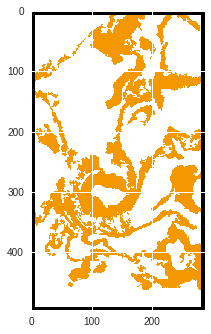

In [ ]:
plt.imshow(valid_mask_data[0])

In [ ]:
create_testing_masks

In [ ]:
test_X_data, test_y_data, test_mask_data = sort_data(X_image_strings_test, testing_directory)

0
11
done
(384, 405, 3)
(384, 416, 3)
3
15
done
(301, 225, 3)
(304, 240, 3)
9
6
done
(439, 234, 3)
(448, 240, 3)
11
9
done
(293, 215, 3)
(304, 224, 3)
4
11
done
(444, 293, 3)
(448, 304, 3)
6
11
done
(234, 213, 3)
(240, 224, 3)
13
8
done
(291, 296, 3)
(304, 304, 3)
15
1
done
(225, 207, 3)
(240, 208, 3)
10
8
done
(486, 408, 3)
(496, 416, 3)
12
9
done
(276, 279, 3)
(288, 288, 3)
8
7
done
(280, 329, 3)
(288, 336, 3)
15
5
done
(321, 315, 3)
(336, 320, 3)
4
0
done
(300, 288, 3)
(304, 288, 3)
5
11
done
(427, 373, 3)
(432, 384, 3)
10
12
done
(438, 228, 3)
(448, 240, 3)
15
9
done
(321, 343, 3)
(336, 352, 3)
4
4
done
(220, 316, 3)
(224, 320, 3)
13
0
done
(387, 320, 3)
(400, 320, 3)
10
1
done
(486, 255, 3)
(496, 256, 3)
10
12
done
(278, 276, 3)
(288, 288, 3)
9
13
done
(231, 291, 3)
(240, 304, 3)
1
5
done
(319, 283, 3)
(320, 288, 3)
5
10
done
(427, 422, 3)
(432, 432, 3)
15
14
done
(273, 306, 3)
(288, 320, 3)
5
11
done
(443, 325, 3)
(448, 336, 3)
7
2
done
(377, 350, 3)
(384, 352, 3)
11
1
done
(261,

In [ ]:
test_mask_data[69].shape

(1824, 1824, 3)

In [ ]:
len(test_X_data)

70

In [ ]:
len(test_y_data)

70

In [ ]:
def create_testing_masks(masks):
  new_masks = list()
  for mask in masks:
    this_mask = mask.copy()
    this_mask = this_mask[:, :,1]
    
    np.putmask(this_mask, this_mask == 0, 0)
    np.putmask(this_mask, this_mask == 255, 0)
    np.putmask(this_mask, this_mask == 64, 1)
    np.putmask(this_mask, this_mask == 128, 2)
    np.putmask(this_mask, this_mask == 152, 3)
    new_masks.append(this_mask)
  return new_masks 

In [ ]:
test_mask_data = create_testing_masks(test_mask_data)

In [ ]:
class WSSS4LUAD_seg_test(Dataset):
  def __init__(self, img_transform=None,mask_transform=None):
    self.x = np.array(test_X_data)
    self.masks = np.array(test_mask_data)
    self.n_samples =  self.x.shape[0]
    self.img_transform = img_transform
    self.mask_transform = mask_transform


  def __getitem__(self,index):
    image = self.x[index]
    mask = self.masks[index]
    image = self.x[index]
    mask = self.masks[index]

    if self.img_transform is not None :
      image = self.img_transform(image)
    if self.mask_transform is not None: 
      mask = self.mask_transform(mask)
    return image, np.array(mask)

  def __len__(self):
    return self.n_samples



In [ ]:
len(test_y_data)

NameError: ignored

In [ ]:
classMetrics = {
      0:{
          'TP':0,
         'FP':0,
         'FN':0,
         'TN':0,
      },
      1:{
          'TP':0,
         'FP':0,
         'FN':0,
         'TN':0,
      },
      2:{
          'TP':0,
         'FP':0,
         'FN':0,
         'TN':0,
      },
      3:{
          'TP':0,
         'FP':0,
         'FN':0,
         'TN':0,
      }
      
  }

In [ ]:
def calculate_metrics(preds, targets,class_metric_dict):
  classes = [0,1,2,3]

  class_metric_mious = {
      'background' : 0,
      'tumour': 0,
      'stroma': 0,
      'normal': 0,
  }
  class_metric_dice = {
      'background' : 0,
      'tumour': 0,
      'stroma': 0,
      'normal': 0,
  }

  for i in range(len(preds)):
    
    for c in classes:
      
      TP = np.sum( (targets[i] == c)&(preds[i].numpy()==c) )
      FP = np.sum( (targets[i] != c)&(preds[i].numpy()==c) )
      FN = np.sum( (targets[i] == c)&(preds[i].numpy() != c)) 
      TN = np.sum( (targets[i] != c)&(preds[i].numpy() != c)) 
      class_metric_dict[c]['TP'] += TP
      class_metric_dict[c]['FP'] += FP
      class_metric_dict[c]['FN'] += FN
      class_metric_dict[c]['TN'] += TN
  
  class_metric_mious['background'] = class_metric_dict[0]['TP']/ float(class_metric_dict[0]['TP'] + class_metric_dict[0]['FP'] + class_metric_dict[0]['FN'])
  class_metric_mious['tumour'] = class_metric_dict[1]['TP']/ float(class_metric_dict[1]['TP'] + class_metric_dict[1]['FP'] + class_metric_dict[1]['FN'])
  class_metric_mious['stroma'] = class_metric_dict[2]['TP']/ float(class_metric_dict[2]['TP'] + class_metric_dict[2]['FP'] + class_metric_dict[2]['FN'])
  class_metric_mious['normal'] = class_metric_dict[3]['TP']/ float(class_metric_dict[3]['TP'] + class_metric_dict[3]['FP'] + class_metric_dict[3]['FN'])


  class_metric_dice['background'] = 2* class_metric_dict[0]['TP']/ float(2 * class_metric_dict[0]['TP'] + class_metric_dict[0]['FP'] + class_metric_dict[0]['FN'])
  class_metric_dice['tumour'] = 2 * class_metric_dict[1]['TP']/ float(2 * class_metric_dict[1]['TP'] + class_metric_dict[1]['FP'] + class_metric_dict[1]['FN'])
  class_metric_dice['stroma'] = 2 * class_metric_dict[2]['TP']/ float(2 * class_metric_dict[2]['TP'] + class_metric_dict[2]['FP'] + class_metric_dict[2]['FN'])
  class_metric_dice['normal'] = 2 * class_metric_dict[3]['TP']/ float(2 * class_metric_dict[3]['TP'] + class_metric_dict[3]['FP'] + class_metric_dict[3]['FN'])
  return class_metric_mious, class_metric_dice




In [ ]:
segmentation_test = WSSS4LUAD_seg_test(img_transform_valid,mask_transform_valid)
dataloader_segmentation_test = DataLoader(dataset = segmentation_test, batch_size = 1, shuffle = False)


In [ ]:
from sklearn.metrics import jaccard_score
from sklearn.preprocessing import MultiLabelBinarizer
from torchmetrics.functional import jaccard_index
def seg_test (dataloader, model):
  progress = tqdm(dataloader)  
  model.eval()
  jaccard = JaccardIndex(num_classes=4, average='none')
  IoU_background = 0.0
  IoU_tumour = 0.0
  IoU_stroma = 0.0
  IoU_normal = 0.0
  cmatrix = np.zeros((4,4))
  tumour_count = 64  
  stroma_count = 68
  normal_count = 3
  count = 1
  cpreds_metrics = list()
  ys = list()
  cpreds = list()


  for batch_idx, (data, masks) in enumerate(progress):
    count += 1 
    data = data.type(torch.FloatTensor)
    X = data.to(device)
    y = masks.type('torch.LongTensor').to(device)

    with torch.set_grad_enabled(False):
       predictions = model(X)
       # Create 4d from prediction
       p=predictions[:,:,:,:].detach().cpu()
       cpred=np.argmax(p,axis=1)
       y_cpu=y.cpu().detach().numpy()
       #jaccard = jaccard_index(average = None,num_classes=4)
       #this_IoU = jaccard(cpred, y_cpu)

       #cpreds_metrics.append(this_IoU)
       ys.append(y_cpu)
       cpreds.append(cpred)
       #torch.stack(cpreds,cpred)
       cpredflat = cpred.flatten()
       yflat = y_cpu.flatten()
       
       cmatrix=cmatrix+confusion_matrix(yflat,cpredflat,labels=range(4))
          #cpreds.append(list(cpredflat.numpy()))
       #ys.append(list(yflat.numpy()))
       #t_b_output = torch.tensor( b_output )
  #print(ys.shape)
      
  all_metrics = {
      'Accuracy': (cmatrix/cmatrix.sum()).trace(),
      'IoU Tumour': IoU_tumour,
      'IoU Stroma': IoU_stroma,
      'IoU Normal': IoU_normal,
      'IoU Background': IoU_background
  }

  
  

  #print(ys)
  #mlb = MultiLabelBinarizer()
  #ys = mlb.fit_transform(ys)
  #cpreds = mlb.fit_transform(cpreds)
  #jaccard_batch_metric = jaccard_score(ys,cpreds, average=None)
  
  

  return  cmatrix, cpreds_metrics, ys, cpreds


      



In [ ]:
model = smp.DeepLabV3Plus(
    encoder_name="resnet50",        # choose encoder, e.g. mobilenet_v2 or efficientnet-b7
    encoder_weights="imagenet",     # use `imagenet` pre-trained weights for encoder initialization
    in_channels=3,                  # model input channels (1 for gray-scale images, 3 for RGB, etc.)
    classes=4,                      # model output channels (number of classes in your dataset)
).to(device)

In [ ]:
IoU_background = jaccard_batch_metric[0]
IoU_tumour = jaccard_batch_metric[1]
  IoU_stroma = jaccard_batch_metric[2]
  IoU_normal = jaccard_batch_metric[3]
  
  all_metrics = {
      'Accuracy': (cmatrix/cmatrix.sum()).trace(),
      'IoU Tumour': IoU_tumour,
      'IoU Stroma': IoU_stroma,
      'IoU Normal': IoU_normal,
      'IoU Background': IoU_background
  }

IndentationError: ignored

In [ ]:
model.load_state_dict(torch.load('/content/gdrive/MyDrive/deeplabplus_1_cutmix.pth')['model_state_dict'])


<All keys matched successfully>

In [ ]:
all_test = seg_test (dataloader_segmentation_test, model)

100%|██████████| 70/70 [00:03<00:00, 17.86it/s]


In [ ]:
classMetrics = {
      0:{
          'TP':0,
         'FP':0,
         'FN':0,
         'TN':0,
      },
      1:{
          'TP':0,
         'FP':0,
         'FN':0,
         'TN':0,
      },
      2:{
          'TP':0,
         'FP':0,
         'FN':0,
         'TN':0,
      },
      3:{
          'TP':0,
         'FP':0,
         'FN':0,
         'TN':0,
      }
      
  }

In [ ]:
all_test[3][0].shape

torch.Size([1, 384, 416])

In [ ]:
print(calculate_metrics(all_test[3], all_test[2],classMetrics)[0])

{'background': 0.6179840360517608, 'tumour': 0.5131105081120871, 'stroma': 0.1868780944626167, 'normal': 0.608317563482665}


In [ ]:
print(calculate_metrics(all_test[3], all_test[2],classMetrics)[1])

{'background': 0.7638938608563514, 'tumour': 0.6782194761865699, 'stroma': 0.3149069737397581, 'normal': 0.7564644909621068}


In [ ]:
def create_example(mask):
    mask = mask
    this_mask = np.zeros((mask.shape[0], mask.shape[1],3),dtype=np.uint8)
    for i in range(len(mask)):
      for j in range(len(mask[0])):
        if mask[i][j] == 0:
          this_mask[i][j] = [255,255,255]
        elif mask[i][j] == 1:
          this_mask[i][j] = [0,64,128]
        elif mask[i][j] == 2:
          this_mask[i][j] = [64,128,0]
        elif mask[i][j] == 3:
          this_mask[i][j] = [243,152,0]
    
    return this_mask 

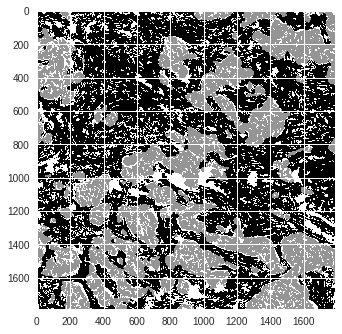

In [ ]:
plt.imshow(all_test[2][68].reshape(1792,1792))

In [ ]:
label_color_dict ={
    0 : ('Background', np.array([255,255,255])),
    1 : ('Tumour',np.array([0,64,128])),
    2 : ('Stroma',np.array([64,128,0])),
    3 : ('Normal',np.array([243,152,0]))
}

([], <a list of 0 Text yticklabel objects>)

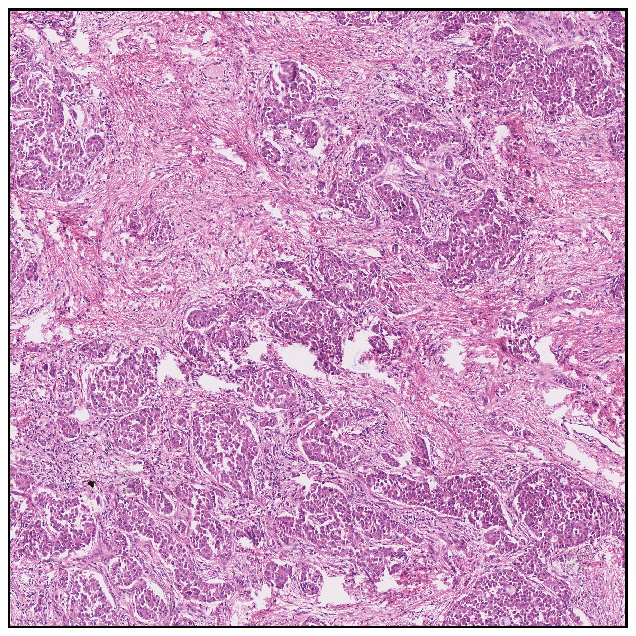

In [ ]:
plt.figure(figsize=(10, 20), dpi=80)

plt.imshow(test_X_data[68])
plt.grid(False)
plt.xticks([])
plt.yticks([])

([], <a list of 0 Text yticklabel objects>)

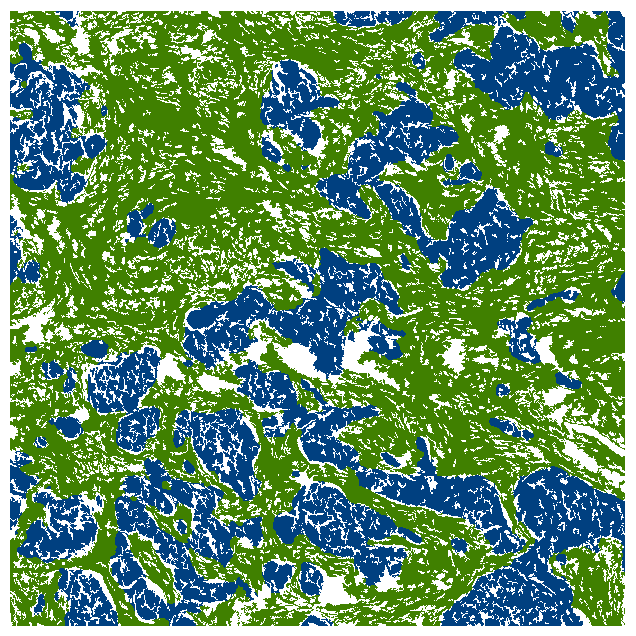

In [ ]:
plt.figure(figsize=(10, 20), dpi=80)
plt.imshow(create_example(all_test[2][68].reshape(1792,1792)))
plt.grid(False)
plt.xticks([])
plt.yticks([])


In [ ]:
overlay = overlay_prediction_mask(
    test_X_data[68], all_test[2][68].reshape(1792,1792), alpha=0.5, label_info=label_color_dict, return_ax=False
)

([], <a list of 0 Text yticklabel objects>)

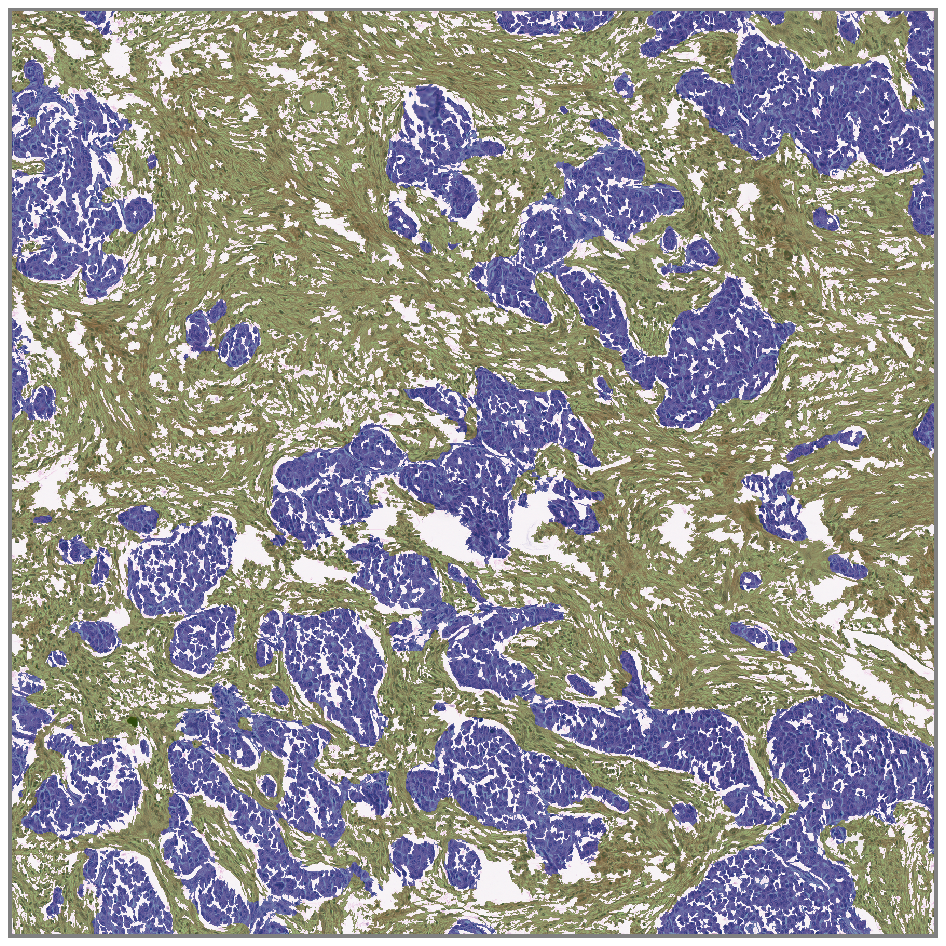

In [ ]:
plt.figure(figsize=(15, 20), dpi=80)
plt.imshow(overlay)
plt.grid(False)
plt.xticks([])
plt.yticks([])

In [ ]:
from tiatoolbox.utils.visualization import overlay_prediction_mask

label_dict = {"Background": 1, "Stroma": 1, "Inflamatory": 2, "Necrosis": 3, "Others": 4}

label_color_dict ={
    0 : ('Background', np.array([255,255,255])),
    1 : ('Tumour',np.array([0,64,128])),
    2 : ('Stroma',np.array([64,128,0])),
    3 : ('Normal',np.array([243,152,0]))
}
# Creat overlay map using the `overlay_prediction_mask` helper function
plt.figure(figsize=(15, 40), dpi=80)
overlay = overlay_prediction_mask(
    test_X_data[68], all_test[3][68].reshape(1792,1792), alpha=0.5, label_info=label_color_dict, return_ax=False
)




<Figure size 1200x3200 with 0 Axes>

([], <a list of 0 Text yticklabel objects>)

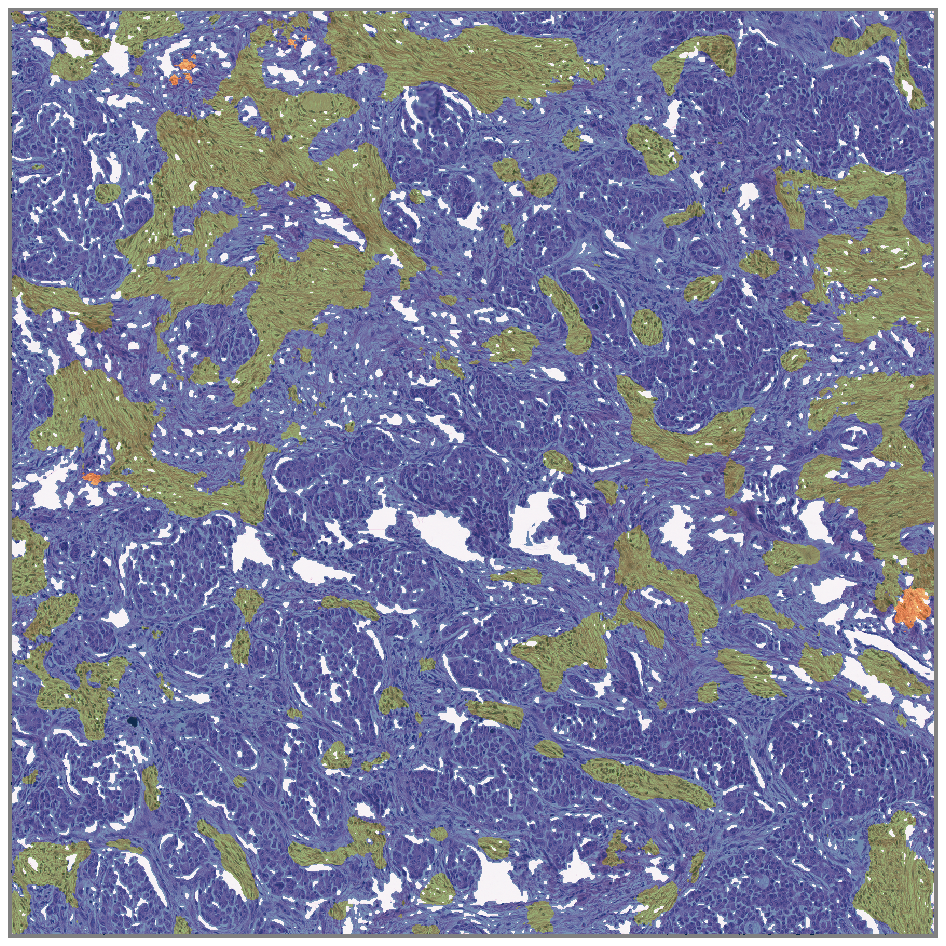

In [ ]:
plt.figure(figsize=(15, 20), dpi=80)
plt.imshow(overlay)
plt.grid(False)
plt.xticks([])
plt.yticks([])

([], <a list of 0 Text yticklabel objects>)

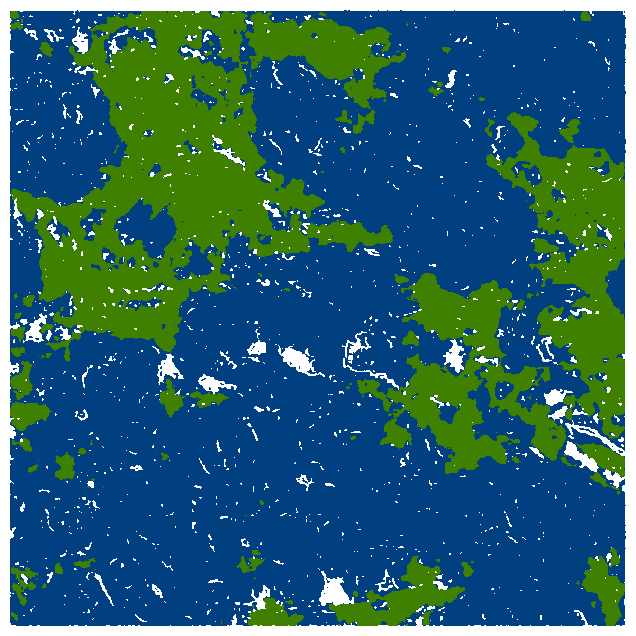

In [ ]:
plt.figure(figsize=(10, 20), dpi=80)
plt.imshow(create_example(all_test[3][68].reshape(1792,1792)))
plt.grid(False)
plt.xticks([])
plt.yticks([])

([], <a list of 0 Text yticklabel objects>)

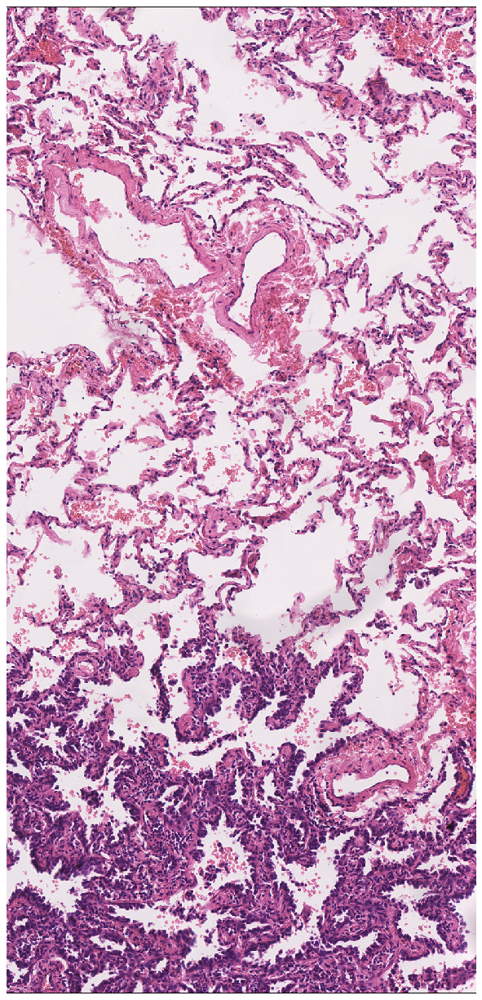

In [ ]:
plt.figure(figsize=(10, 20), dpi=80)

plt.imshow(test_X_data[67])
plt.grid(False)
plt.xticks([])
plt.yticks([])

([], <a list of 0 Text yticklabel objects>)

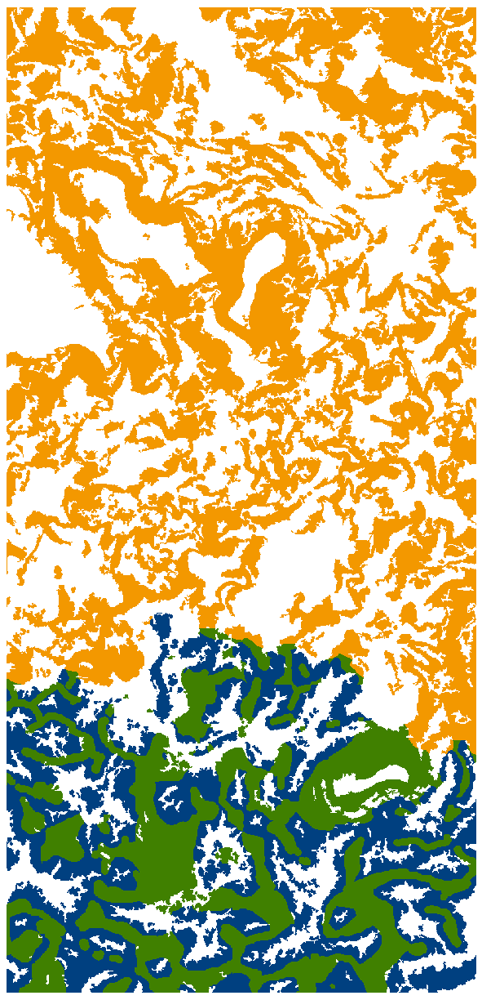

In [ ]:
plt.figure(figsize=(10, 20), dpi=80)

plt.imshow(create_example(all_test[2][67].reshape(1712,816)))
plt.grid(False)
plt.xticks([])
plt.yticks([])

In [ ]:
overlay = overlay_prediction_mask(
    test_X_data[67], all_test[2][67].reshape(1712,816), alpha=0.5, label_info=label_color_dict, return_ax=False
)

([], <a list of 0 Text yticklabel objects>)

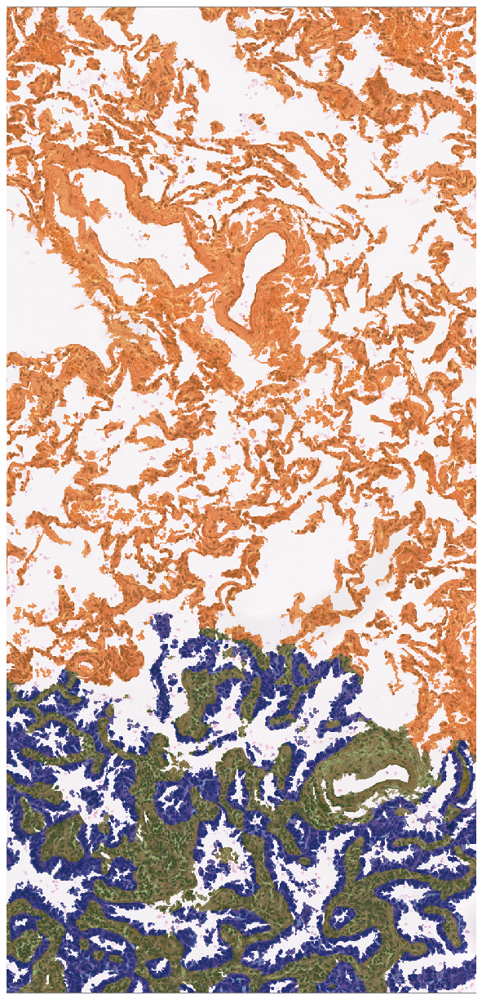

In [ ]:
plt.figure(figsize=(15, 20), dpi=80)
plt.imshow(overlay)
plt.grid(False)
plt.xticks([])
plt.yticks([])

([], <a list of 0 Text yticklabel objects>)

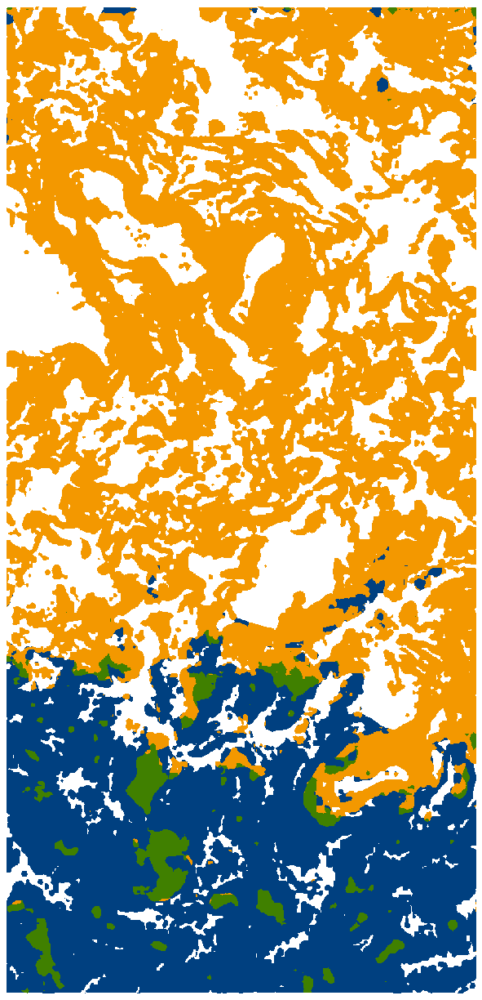

In [ ]:
plt.figure(figsize=(10, 20), dpi=80)

plt.imshow(create_example(all_test[3][67].reshape(1712,816)))
plt.grid(False)
plt.xticks([])
plt.yticks([])

In [ ]:
overlay = overlay_prediction_mask(
    test_X_data[67], all_test[3][67].reshape(1712,816), alpha=0.5, label_info=label_color_dict, return_ax=False
)

([], <a list of 0 Text yticklabel objects>)

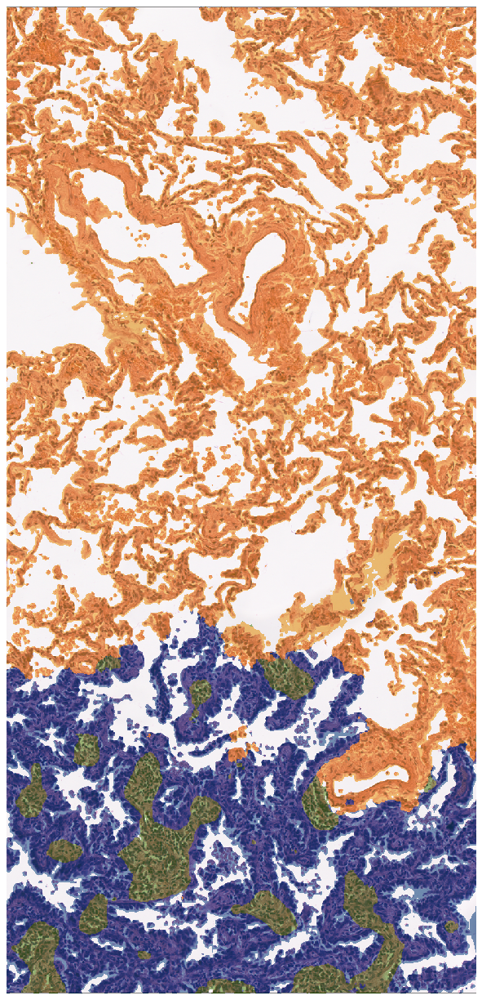

In [ ]:
plt.figure(figsize=(15, 20), dpi=80)
plt.imshow(overlay)
plt.grid(False)
plt.xticks([])
plt.yticks([])

([], <a list of 0 Text yticklabel objects>)

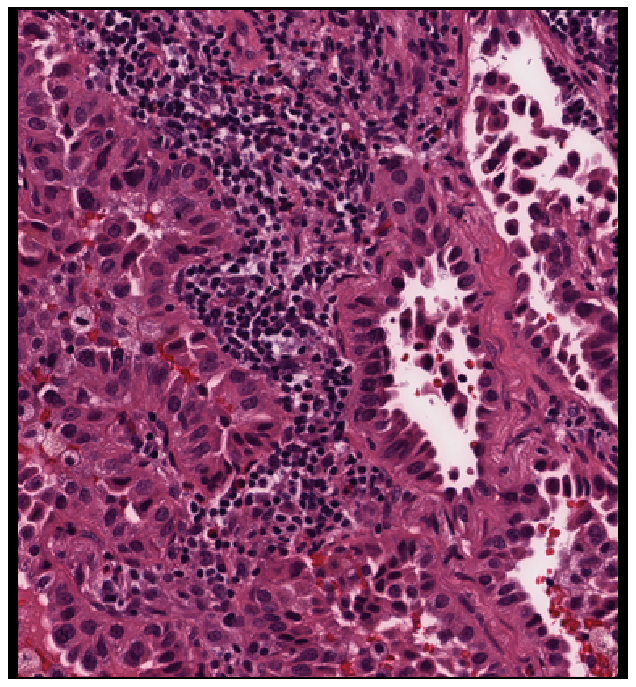

In [ ]:
plt.figure(figsize=(10, 20), dpi=80)

plt.imshow(test_X_data[65])
plt.grid(False)
plt.xticks([])
plt.yticks([])

([], <a list of 0 Text yticklabel objects>)

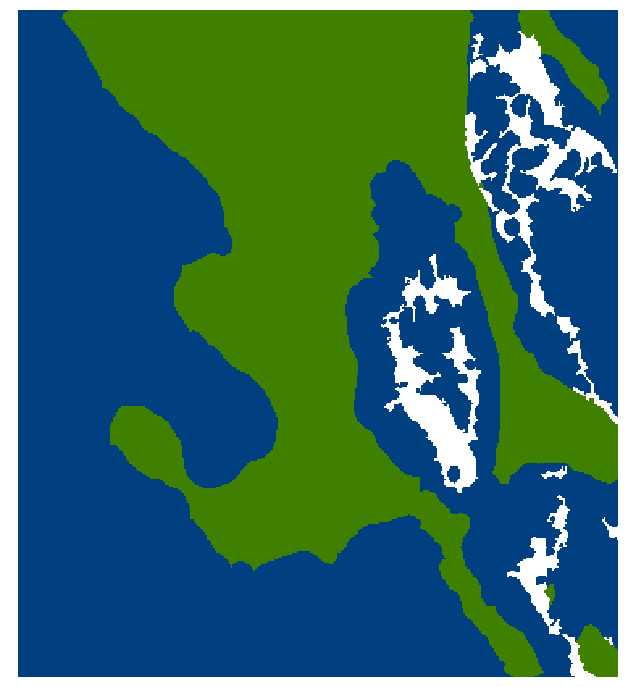

In [ ]:
plt.figure(figsize=(10, 20), dpi=80)

plt.imshow(create_example(all_test[2][65].reshape(416,384)))
plt.grid(False)
plt.xticks([])
plt.yticks([])

In [ ]:
overlay = overlay_prediction_mask(
    test_X_data[65], all_test[2][65].reshape(416,384), alpha=0.5, label_info=label_color_dict, return_ax=False
)

([], <a list of 0 Text yticklabel objects>)

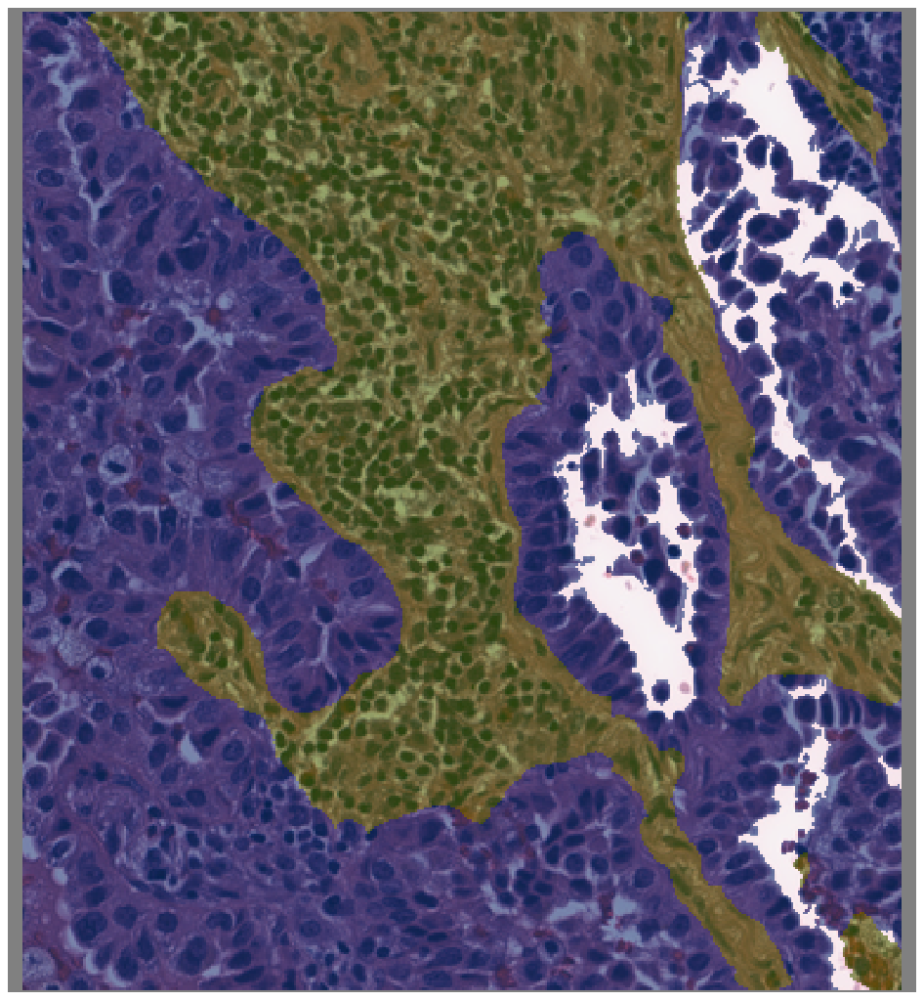

In [ ]:
plt.figure(figsize=(15, 20), dpi=80)
plt.imshow(overlay)
plt.grid(False)
plt.xticks([])
plt.yticks([])

([], <a list of 0 Text yticklabel objects>)

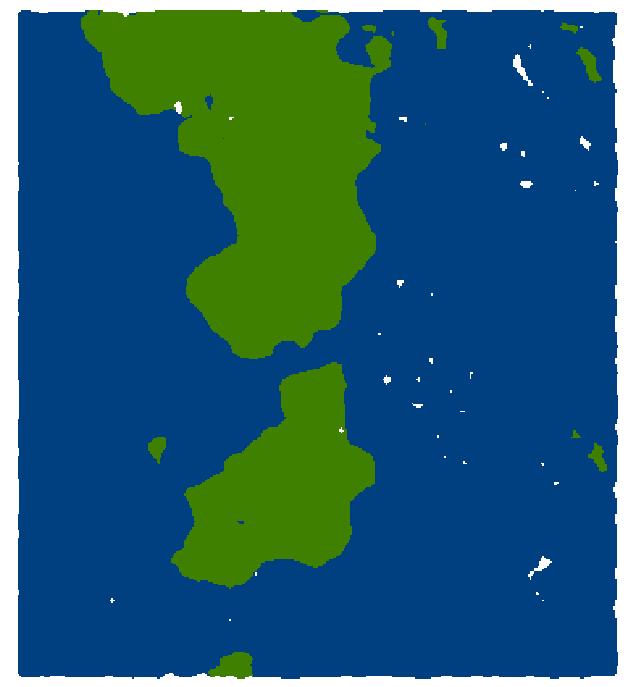

In [ ]:
plt.figure(figsize=(10, 20), dpi=80)

plt.imshow(create_example(all_test[3][65].reshape(416,384)))
plt.grid(False)
plt.xticks([])
plt.yticks([])

In [ ]:
overlay = overlay_prediction_mask(
    test_X_data[65], all_test[3][65].reshape(416,384), alpha=0.5, label_info=label_color_dict, return_ax=False
)

([], <a list of 0 Text yticklabel objects>)

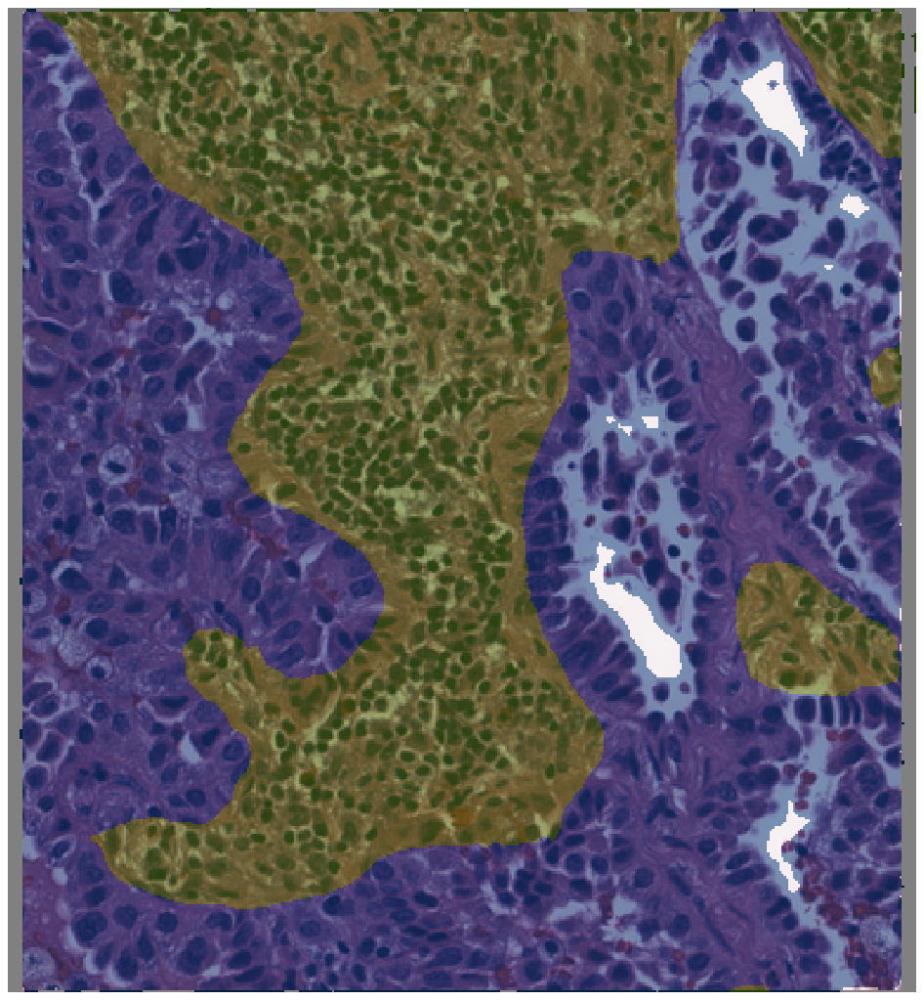

In [ ]:
plt.figure(figsize=(15, 20), dpi=80)
plt.imshow(overlay)
plt.grid(False)
plt.xticks([])
plt.yticks([])

([], <a list of 0 Text yticklabel objects>)

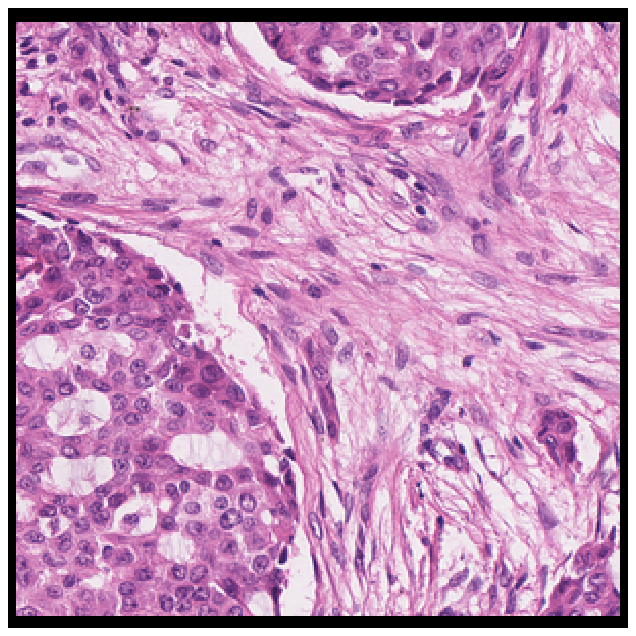

In [ ]:
plt.figure(figsize=(10, 20), dpi=80)

plt.imshow(test_X_data[6])
plt.grid(False)
plt.xticks([])
plt.yticks([])

In [ ]:
test_X_data[6].shape

(304, 304, 3)

([], <a list of 0 Text yticklabel objects>)

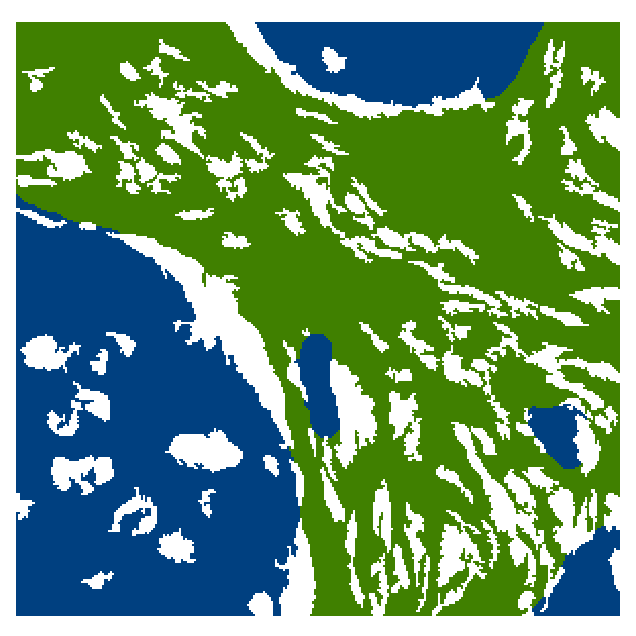

In [ ]:
plt.figure(figsize=(10, 20), dpi=80)
plt.imshow(create_example(all_test[2][6].reshape(304,304)))
plt.grid(False)
plt.xticks([])
plt.yticks([])

In [ ]:
overlay = overlay_prediction_mask(
    test_X_data[6], all_test[2][6].reshape(304,304), alpha=0.5, label_info=label_color_dict, return_ax=False
)

([], <a list of 0 Text yticklabel objects>)

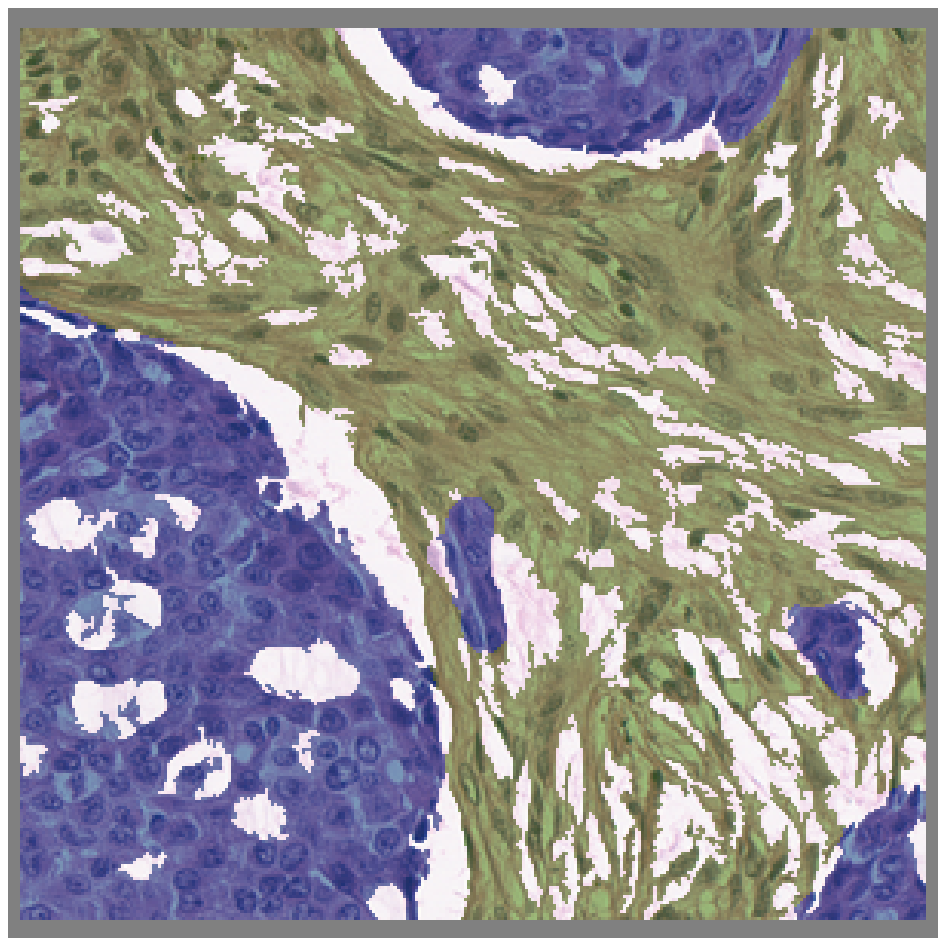

In [ ]:
plt.figure(figsize=(15, 20), dpi=80)
plt.imshow(overlay)
plt.grid(False)
plt.xticks([])
plt.yticks([])

([], <a list of 0 Text yticklabel objects>)

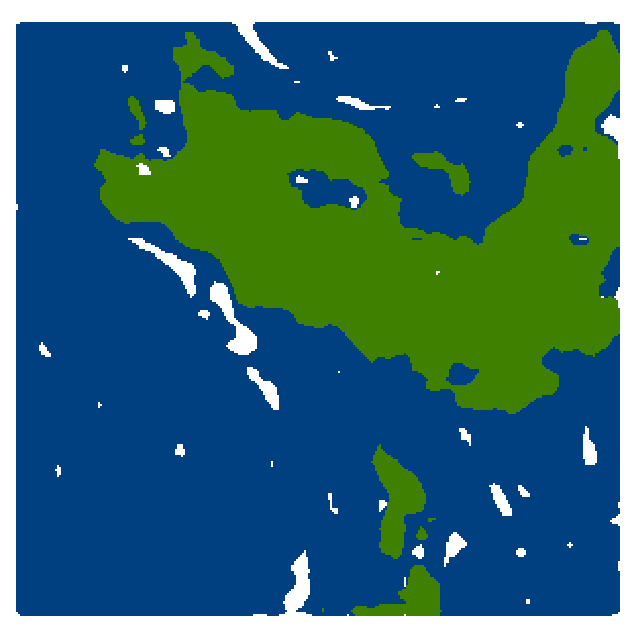

In [ ]:
plt.figure(figsize=(10, 20), dpi=80)
plt.imshow(create_example(all_test[3][6].reshape(304,304)))
plt.grid(False)
plt.xticks([])
plt.yticks([])

In [ ]:
overlay = overlay_prediction_mask(
    test_X_data[6], all_test[3][6].reshape(304,304), alpha=0.5, label_info=label_color_dict, return_ax=False
)

([], <a list of 0 Text yticklabel objects>)

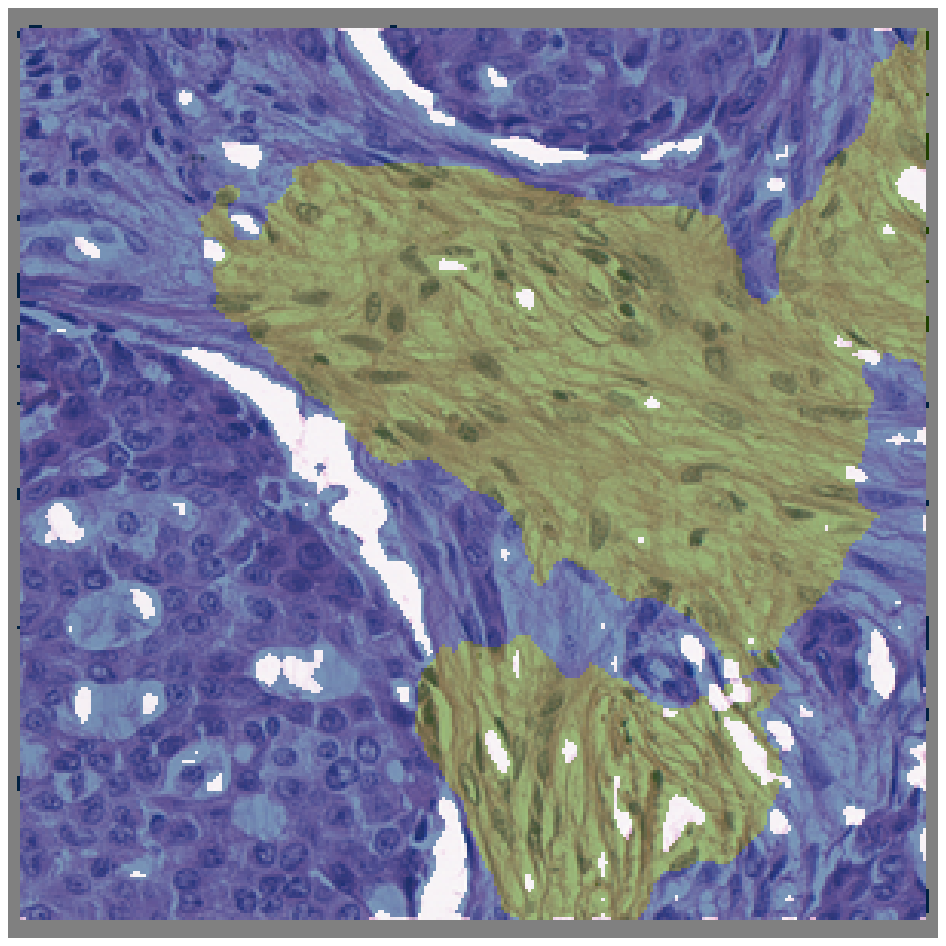

In [ ]:
plt.figure(figsize=(15, 20), dpi=80)
plt.imshow(overlay)
plt.grid(False)
plt.xticks([])
plt.yticks([])